<a href="https://colab.research.google.com/github/Jaquelinedops/PhishingHunter/blob/main/PhishingHunter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Autores: Pedro Chagas Junior, Jaqueline Damacena Duarte, Laerte Peotta de Mello
## Título: Sistema de Inteligência artificial para detecção de phishing em domínios estacionados
## Certificado de Registro de Programa de Computador BR512024003536-2 - INPI

In [ ]:
!pip install scikit-learn==1.5.2



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
pip install shap

Note: you may need to restart the kernel to use updated packages.



[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
!pip install jinja2


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
#pip install -r '/content/drive/MyDrive/Phishing_hunter_review/source_code/requirements.txt'

In [ ]:
!pip install tld


[notice] A new release of pip is available: 25.0.1 -> 25.1.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
# prompt: conect to google drive

#from google.colab import drive
#drive.mount('/content/drive')

#path_source_code = '/content/drive/MyDrive/Phishing_hunter_review/source_code/'
#path_dataset = '/content/drive/MyDrive/Phishing_hunter_review/source_code/dataset/'
path_source_code = ''
path_dataset = ''


###Import dependencies


In [ ]:
# -*- coding: utf-8 -*-
import joblib
from nltk.stem import RSLPStemmer
from sklearn.pipeline import Pipeline
import nltk
nltk.download('rslp')
import re
import jellyfish
import numpy as np
import pandas as pd
import seaborn as sns
import itertools
import seaborn
from tld import get_tld
import os.path
from urllib.parse import urlparse
from sklearn.linear_model import LogisticRegression
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error,confusion_matrix, precision_score, recall_score, auc,roc_curve, f1_score
from sklearn.model_selection import train_test_split
from nltk.tokenize import RegexpTokenizer
import pandas as pd
import numpy as np
import random
import math
from collections import Counter
from sklearn import metrics
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report,confusion_matrix,accuracy_score,roc_auc_score
from sklearn.feature_extraction.text import CountVectorizer
import xgboost as xgb
from lightgbm import LGBMClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
import os
import socket
from datetime import datetime
import time
from bs4 import BeautifulSoup
import urllib
import bs4
import os
import sys
from sklearn.preprocessing import StandardScaler  # to standardize the features
from sklearn.decomposition import PCA  # to apply PCA
import seaborn as sns  # to plot the heat maps
sys.path.append(path_source_code) # Replace with the actual path to the directory containing confusables.py
from confusables import unconfuse
import warnings
from sklearn.datasets import make_classification
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.model_selection import RandomizedSearchCV
from sklearn.feature_selection import SelectFromModel
from sklearn.pipeline import Pipeline
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import make_scorer

from scipy.stats import randint
from scipy import stats



# configurando pandas para mostrar todas as lincontains e colunas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# configurando pandas para não mostrar notação científica para números
pd.set_option('display.float_format', lambda x: '%.2f' % x)



### BASE DE DADOS

In [ ]:
df = pd.read_csv(path_dataset+'phishing_dataset.csv',sep=",")
df = df[['url', 'label']]
df.drop_duplicates('url', inplace=True)
df.dropna(inplace=True)
sns.countplot(data=df, x='label')


Executa o substuição de caracteres confusable pelo respectivo latin-1
corrige o protocolo no inicio das urls




In [ ]:
def fix_url(url):
  if url.startswith("*."):
    url = "https://" + url[2:]
    url = url.replace("hxxp://","http://")
    url = url.replace("hxxps://","https://")
    url = url.replace("http://.","http://")
  if not url.startswith('http'):
    url = 'http://' + url
  return url

df['url'] = df['url'].apply(fix_url)
df = df.assign(url_original = df.url)
df = df.assign(url = df.url.apply(lambda x: unconfuse(x)[0]))


Verifica termos mais frequentes na URLs da classe alvo

### FEATURE MINING AND ENGINEERING


In [ ]:
## Variável frequent_terms
stop_words = ['do','ddm','bit','home','co','m','blogspot','index', 'site','pagina','wp','i','a','z13','php','html','biz','content','id','api','6otvybu4aq','web','windows','core']
positive_pattern  = df[df.label == 1]
# Função para extrair termos da URL excluindo o TLD
def extract_terms(url):
    parsed_url = urlparse(url)
    domain = parsed_url.netloc
    path = parsed_url.path
    # Remove o TLD
    domain = re.sub(r'\.[a-z]{2,}$', '', domain)
    # Divide o domínio e o caminho em termos
    terms = re.split(r'\W+', domain + path)
    return terms

# Extrair termos de todas as URLs
all_terms = []
for url in positive_pattern.url.to_list():
    terms = extract_terms(url)
    all_terms.extend(terms)
filtered_terms = [term for term in all_terms if term.lower() not in stop_words and term]

stemmer = RSLPStemmer()
stemmezed_terms = [stemmer.stem(palavra) for palavra in filtered_terms]
stemmezed_terms = [term for term in stemmezed_terms if term.lower() not in stop_words and term]


# Contar frequência dos termos
term_freq = Counter(stemmezed_terms)
filtered_term_freq = Counter({term: freq for term, freq in term_freq.items() if len(term) > 1})

# Obter os termos mais frequentes
frequent_terms = filtered_term_freq.most_common(50)
frequent_terms = pd.DataFrame(frequent_terms, columns=['token', 'count']).token.to_list()
lista_pattern_abuse = list()
pattern = frequent_terms
for url in df.url:
    total = 0
    for substring in pattern:
        qtd_substring = url.count(substring)
        total = total + qtd_substring

    if total != 0:
       lista_pattern_abuse.append(total)
    else:
        lista_pattern_abuse.append(0)

df["frequent_terms"] = lista_pattern_abuse
df["frequent_terms"].value_counts()

df[["url","label"]][df["frequent_terms"] == 1].head()
df[["url","label"]][df["frequent_terms"] == 10].head()
df[df["frequent_terms"] == 16]

df["url"].iloc[2697]

df.head()


,url,label,url_original,frequent_terms
0,http://sarahmutschler.com,0.00,http://sarahmutschler.com,1
1,http://95.l8l.l73.204/aN7jD0qO6kT5bK5bQ4eR8fEl...,0.00,http://95.181.173.204/aN7jD0qO6kT5bK5bQ4eR8fE1...,0
2,http://smart-lock-94300.bond,0.00,http://smart-lock-94300.bond,0
3,http://doumbe.fr,0.00,http://doumbe.fr,0
4,http://alliedteaml.com,0.00,http://alliedteam1.com,1


In [ ]:
frequent_terms

['bb',
 'acess',
 'iivi',
 'www',
 'com',
 'login',
 'gerenci',
 'resgat',
 'pc',
 'client',
 'onderesgat',
 'app',
 'livel',
 'inici',
 'run',
 'jurid',
 'rj',
 'pont',
 'pj',
 'br',
 'segur',
 'fisic',
 'hmtl',
 'brasil',
 'chav',
 'atend',
 'senh',
 'empr',
 'bal',
 'zl3',
 'mobil',
 'port',
 'bancodobrasil',
 'cont',
 'index_',
 'desktop',
 'click',
 'autoatend',
 'inic',
 'pow',
 'pe',
 'inicio_fis',
 'modul',
 'digit',
 'ww',
 'zl',
 'control',
 'contat',
 'oppc',
 'loginbb']

In [ ]:
"""### Variável Contém SponseredTLD"""

sTLD = pd.read_csv(path_dataset +'sponsored_top_level_domain.csv')
filtered_tlds = pd.read_csv(path_dataset +'most_frequent_tld.csv')
tld_list =[]
tlds = sTLD.tld.to_list()
for url in df["url"]:
    flag = False
    for tld in tlds:
        if tld in url:
            tld_list.append(1)
            flag = True
            break
    if flag == False:
        tld_list.append(0)

df["contains_sTLD"] = tld_list
df["contains_sTLD"].value_counts().head()

contains_sTLD
0    210850
1       809
Name: count, dtype: int64

In [ ]:
"""#### URL ANORMAL

Uma url é considerada normal quando possui protocolo e o hostname
"""

list_abnormal_url = list()
for url in df["url"]:
    url = url.replace('->','/').replace('\\','/')
    hostname = urlparse(url).hostname
    hostname = str(hostname)
    print(hostname, ' ', url)
    try:
        match = re.search(hostname, url)

        if match:
            # print match.group()
            list_abnormal_url.append(1)
        else:
            # print 'No matching pattern found'
            list_abnormal_url.append(0)
    except:
        list_abnormal_url.append(1)

df["abnormal_url"] = list_abnormal_url
df["abnormal_url"].value_counts()


sarahmutschler.com   http://sarahmutschler.com
95.l8l.l73.204   http://95.l8l.l73.204/aN7jD0qO6kT5bK5bQ4eR8fElxP7hL2vK/freebl3.dll
smart-lock-94300.bond   http://smart-lock-94300.bond
doumbe.fr   http://doumbe.fr
alliedteaml.com   http://alliedteaml.com
tianoqvi.online   http://tianoqvi.online
dinogarri.com   http://dinogarri.com
atomic-increase.pro   http://atomic-increase.pro
shareoncryto.net   http://shareoncryto.net
s.free.fr   https://s.free.fr/4ikcFFnP
cloudflare-ipfs.com   https://cloudflare-ipfs.com/ipfs/bafybeig6qjsdrwnowmlxd6bntxumaedr5ovdcovbrfmerwmcmvb7c7zhou/jooocj.html
autowinx222.click   http://autowinx222.click
rf-hermes.online   http://rf-hermes.online
partytown.co.uk   http://partytown.co.uk
redq.store   http://redq.store
saasc.net   http://saasc.net
sol.trade   http://sol.trade
pitcherwitspress.co.uk   http://pitcherwitspress.co.uk
cuidartupiel.com   http://cuidartupiel.com
chrisamoore.com   http://chrisamoore.com
boilersandbathroom.co.uk   http://boilersandbathroom.

abnormal_url
1    211609
0        50
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de (.)"""

df['quantity(.)'] = df['url'].apply(lambda i: i.count('.'))
df['quantity(.)'].value_counts()
df["quantity(.)"][df["label"] == 0].value_counts()
df[(df["quantity(.)"] == 1) & (df["label"] == 0)].head()

,url,label,url_original,frequent_terms,contains_sTLD,abnormal_url,quantity(.)
0,http://sarahmutschler.com,0.00,http://sarahmutschler.com,1,0,1,1
2,http://smart-lock-94300.bond,0.00,http://smart-lock-94300.bond,0,0,1,1
3,http://doumbe.fr,0.00,http://doumbe.fr,0,0,1,1
4,http://alliedteaml.com,0.00,http://alliedteam1.com,1,0,1,1
5,http://tianoqvi.online,0.00,http://tianoqvi.online,0,0,1,1


In [ ]:
"""#### Quantidade de WW"""

df['quantity(ww)'] = df['url'].apply(lambda i: i.count('ww'))
df['quantity(ww)'].value_counts()

quantity(ww)
0    205554
1      6038
2        64
3         3
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de @"""

df['quantity(@)'] = df['url'].apply(lambda i: i.count('@'))
df['quantity(@)'].value_counts()

quantity(@)
0    210713
1       890
3        15
5        11
2        10
4         9
6         5
7         5
9         1
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de %"""

df['quantity(%)'] = df['url'].apply(lambda i: i.count('%'))
df['quantity(%)'].value_counts()

quantity(%)
0     208383
1       1874
5        300
2        257
3        175
6        135
4        114
7         95
9         56
15        34
10        22
8         21
24        18
21        17
14        14
22        14
25        14
28        13
36        11
20        11
11        10
12         8
23         8
16         7
26         6
39         4
37         4
19         4
33         4
34         3
13         3
27         3
38         3
35         2
30         2
40         2
51         1
54         1
18         1
47         1
17         1
29         1
41         1
43         1
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de ?"""

df['quantity(?)'] = df['url'].apply(lambda i: i.count('?'))
df['quantity(?)'].value_counts()

quantity(?)
0    197005
1     14321
2       227
3       104
4         1
5         1
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de (-)"""

df['quantity(-)'] = df['url'].apply(lambda i: i.count('-'))
df['quantity(-)'].value_counts()

quantity(-)
0     165711
1      26764
2      10580
3       4341
4       2056
5        888
6        500
8        459
7        251
9         33
10        14
16        11
21        11
12        10
22         8
11         5
15         4
13         4
17         4
14         2
53         1
19         1
27         1
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de ="""

df['quantity(=)'] = df['url'].apply(lambda i: i.count('='))
df['quantity(=)'].value_counts()

quantity(=)
0     201247
1       5660
2       2627
3        755
4        714
7        168
8        135
6        121
5         95
10        87
9         29
14         8
12         5
11         3
29         2
16         1
51         1
15         1
Name: count, dtype: int64

In [ ]:
"""#### Tamanho da URL"""

df['url_lenght'] = df['url'].apply(lambda i: len(str(i)))
df['url_lenght'].value_counts().head(15)

url_lenght
17    13321
22    11032
21    10592
23    10464
20    10213
19     9390
24     9357
25     9045
18     8776
26     8030
27     7777
28     7354
29     6520
30     5993
34     5153
Name: count, dtype: int64

In [ ]:
"""##### Tamanho do Host Name"""

df['lenght_hostname'] = df['url'].apply(lambda i: len(urlparse(i).netloc))

In [ ]:
"""#### Contém endereço IP"""

list_ip = list()
for url in df["url"]:
    ip_url = re.search(r'\b(?:[0-9]{1,3}\.){3}[0-9]{1,3}\b', url)
    if ip_url:
        list_ip.append(1)
    else:
        list_ip.append(0)

df["contains_ip"] = list_ip
df["contains_ip"].value_counts()

contains_ip
0    210958
1       701
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de Diretórios"""

lista_qtd_diretorios = list()
for url in df["url"]:
    urldir = urlparse(url).path
    if urldir.count('/') > 0:
        qtd_dir = int(urldir.count('/')) -1
        lista_qtd_diretorios.append(qtd_dir)
    else:
        lista_qtd_diretorios.append(0)

df['quantity_directories'] = lista_qtd_diretorios
df['quantity_directories'].value_counts().head()

quantity_directories
0    179685
1     21849
2      5825
3      2106
4      1521
Name: count, dtype: int64

In [ ]:
"""#### Contém Encutador de URL"""

list_shortner = list()
for url in df["url"]:
    encurtadores = ['bit.ly','goo.gl','shorte.st','go2l.ink','x.co','ow.ly','t.co','tinyurl','tr.im','is.gd','cli.gs',''
                      'yfrog.com','migre.me','ff.im','tiny.cc','url4.eu','twit.ac','su.pr','twurl.nl','snipurl.com',''
                      'short.to','BudURL.com','ping.fm','post.ly','Just.as','bkite.com','snipr.com','fic.kr','loopt.us',''
                      'doiop.com','short.ie','kl.am','wp.me','rubyurl.com','om.ly','to.ly','bit.do','t.co','lnkd.in',''
                      'db.tt','qr.ae','adf.ly','goo.gl','bitly.com','cur.lv','tinyurl.com','ow.ly','bit.ly','ity.im',''
                      'q.gs','is.gd','po.st','bc.vc','twitthis.com','u.to','j.mp','buzurl.com','cutt.us','u.bb','yourls.org',''
                      'x.co','prettylinkpro.com','scrnch.me','filoops.info','vzturl.com','qr.net','1url.com','tweez.me','v.gd',''
                      'tr.im','link.zip.net']
    pattern_encurtador = re.compile(r'(https?://)?(' + '|'.join(encurtadores) + r')/\w+')
    if pattern_encurtador.match(url):
        list_shortner.append(1)
    else:
        list_shortner.append(0)

df["contains_shortner"] = list_shortner
df["contains_shortner"].value_counts()

contains_shortner
0    211140
1       519
Name: count, dtype: int64

In [ ]:
"""#### Tamanho do primeiro diretório"""

list_fd = list()
for url in df["url"]:
    urlpath= urlparse(url).path
    try:
        list_fd.append(len(urlpath.split('/')[1]))
    except:
        list_fd.append(0)

df["lenght_fd"] = list_fd
df["lenght_fd"].value_counts().head()

lenght_fd
0     157834
4       9102
2       6950
6       6817
10      3606
Name: count, dtype: int64

In [ ]:
"""#### Tamanho do TLD"""

list_len_tld = list()
for url in df["url"]:
    tld = get_tld(url,fail_silently=True)
    if tld != None:
        list_len_tld.append(len(str(get_tld(url,fail_silently=True))))
    else:
        list_len_tld.append(0)

df["lenght_tld"] = list_len_tld
df["lenght_tld"].value_counts().head()

lenght_tld
3    116460
4     24646
6     16174
0     14325
2     14284
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de Números"""

list_qtt_nrs = list()
for url in df["url"]:
    digits = 0
    for i in url:
        if i.isnumeric():
            digits = digits + 1

    list_qtt_nrs.append(digits)

df["quantity_numeric"] = list_qtt_nrs
df["quantity_numeric"].value_counts().head()

quantity_numeric
0    133080
1     12066
2      9759
3      6430
5      5564
Name: count, dtype: int64

In [ ]:
"""#### Quantidade de Letras"""

list_qtt_letters = list()
for url in df["url"]:
    letters = 0
    for i in url:
        if i.isalpha():
            letters = letters + 1
    list_qtt_letters.append(letters)

df["quantity_letters"] = list_qtt_letters
df["quantity_letters"].value_counts().head()

for url in df['url']:
    hostname = urlparse(str(url)).hostname
    tam_sub = 0
    if hostname:
        qtd = hostname.count('.')
        if qtd <= 3:
            subdomain = hostname.split('.')[:-2]
            tam_sub = len(subdomain)
        elif qtd > 3:
            subdomain = hostname.split('.')[:-4]
            tam_sub = len(subdomain)

        print(url,hostname, tam_sub)
    else:
        print(url)

100 * len(df.loc[df['label'] == 0]) / df.shape[0]

df.describe().T

http://sarahmutschler.com sarahmutschler.com 0
http://95.l8l.l73.204/aN7jD0qO6kT5bK5bQ4eR8fElxP7hL2vK/freebl3.dll 95.l8l.l73.204 2
http://smart-lock-94300.bond smart-lock-94300.bond 0
http://doumbe.fr doumbe.fr 0
http://alliedteaml.com alliedteaml.com 0
http://tianoqvi.online tianoqvi.online 0
http://dinogarri.com dinogarri.com 0
http://atomic-increase.pro atomic-increase.pro 0
http://shareoncryto.net shareoncryto.net 0
https://s.free.fr/4ikcFFnP s.free.fr 1
https://cloudflare-ipfs.com/ipfs/bafybeig6qjsdrwnowmlxd6bntxumaedr5ovdcovbrfmerwmcmvb7c7zhou/jooocj.html cloudflare-ipfs.com 0
http://autowinx222.click autowinx222.click 0
http://rf-hermes.online rf-hermes.online 0
http://partytown.co.uk partytown.co.uk 1
http://redq.store redq.store 0
http://saasc.net saasc.net 0
http://sol.trade sol.trade 0
http://pitcherwitspress.co.uk pitcherwitspress.co.uk 1
http://cuidartupiel.com cuidartupiel.com 0
http://chrisamoore.com chrisamoore.com 0
http://boilersandbathroom.co.uk boilersandbathroom.co

,count,mean,std,min,25%,50%,75%,max
label,211659.00,0.20,0.40,0.00,0.00,0.00,0.00,1.00
frequent_terms,211659.00,1.17,1.64,0.00,0.00,1.00,1.00,117.00
contains_sTLD,211659.00,0.00,0.06,0.00,0.00,0.00,0.00,1.00
abnormal_url,211659.00,1.00,0.02,0.00,1.00,1.00,1.00,1.00
quantity(.),211659.00,1.62,1.11,0.00,1.00,1.00,2.00,28.00
quantity(ww),211659.00,0.03,0.17,0.00,0.00,0.00,0.00,3.00
quantity(@),211659.00,0.01,0.10,0.00,0.00,0.00,0.00,9.00
quantity(%),211659.00,0.06,0.88,0.00,0.00,0.00,0.00,54.00
quantity(?),211659.00,0.07,0.27,0.00,0.00,0.00,0.00,5.00
quantity(-),211659.00,0.39,1.01,0.00,0.00,0.00,0.00,53.00


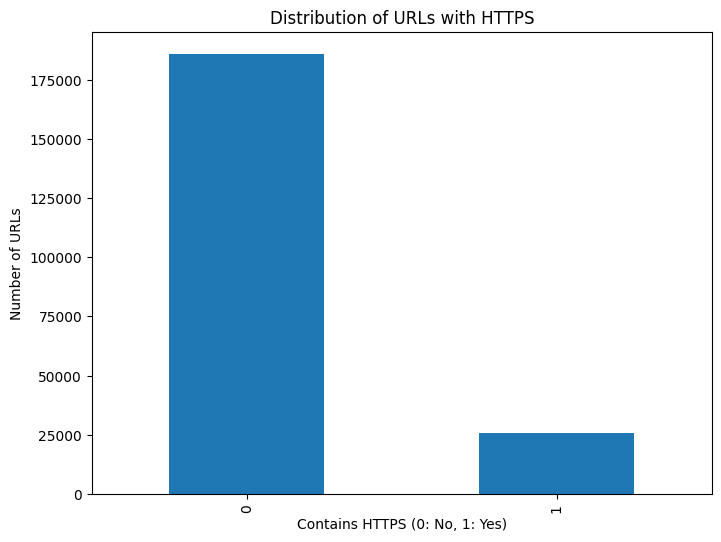

In [ ]:

"""PROTOCOLOS DA URL"""


df = df.assign(contains_https = df.url.apply(lambda x: 1 if x.startswith('https') else 0))
plt.figure(figsize=(8, 6))
df['contains_https'].value_counts().plot(kind='bar')
plt.title('Distribution of URLs with HTTPS')
plt.xlabel('Contains HTTPS (0: No, 1: Yes)')
plt.ylabel('Number of URLs')
plt.show()

In [ ]:
df.columns


Index(['url', 'label', 'url_original', 'frequent_terms', 'contains_sTLD',
       'abnormal_url', 'quantity(.)', 'quantity(ww)', 'quantity(@)',
       'quantity(%)', 'quantity(?)', 'quantity(-)', 'quantity(=)',
       'url_lenght', 'lenght_hostname', 'contains_ip', 'quantity_directories',
       'contains_shortner', 'lenght_fd', 'lenght_tld', 'quantity_numeric',
       'quantity_letters', 'contains_https'],
      dtype='object')

In [ ]:
X_columns = [ 'frequent_terms', 'contains_sTLD',
       'abnormal_url', 'quantity(.)', 'quantity(ww)', 'quantity(@)',
       'quantity(%)', 'quantity(?)', 'quantity(-)', 'quantity(=)',
       'url_lenght', 'lenght_hostname', 'contains_ip', 'quantity_directories',
       'contains_shortner', 'lenght_fd', 'lenght_tld', 'quantity_numeric',
       'quantity_letters', 'contains_https']

In [ ]:
### TRAIN TEST SPLIT

#Predictor Variables
X = df[X_columns]

#Target Variable
y = df['label']

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, shuffle=True, random_state=42)

In [ ]:
X_train.columns

Index(['frequent_terms', 'contains_sTLD', 'abnormal_url', 'quantity(.)',
       'quantity(ww)', 'quantity(@)', 'quantity(%)', 'quantity(?)',
       'quantity(-)', 'quantity(=)', 'url_lenght', 'lenght_hostname',
       'contains_ip', 'quantity_directories', 'contains_shortner', 'lenght_fd',
       'lenght_tld', 'quantity_numeric', 'quantity_letters', 'contains_https'],
      dtype='object')

In [ ]:
nfold_results = []
time_to_predict = []
cv_scores = pd.DataFrame()

In [ ]:
params_grid_lgbm = {
    'lgbm__n_estimators': [50, 100, 200, 300],
    'lgbm__learning_rate': [0.001, 0.01, 0.05, 0.1],
    'lgbm__num_leaves': [30, 50, 70, 90],
    'lgbm__max_depth': [4, 6,8, 10],
    'lgbm__min_child_samples': [20, 50, 100],
    'lgbm__reg_alpha': [0, 0.1, 0.5, 1],
    'lgbm__reg_lambda': [0, 0.1, 0.5, 1]
}


params_grid_rf ={
    'rfc__n_estimators': [50,100, 200, 300],
    'rfc__criterion': ['gini', 'entropy'],
    'rfc__max_depth': [None, 5, 10, 20],
    'rfc__min_samples_split': [2, 5, 10],
    'rfc__min_samples_leaf': [1, 2, 4],
    'rfc__max_features': [None,'sqrt', 'log2']
}


param_grid_xgb = {
    'xgb__n_estimators': [50, 100, 200, 300],
    'xgb__learning_rate': [0.001, 0.01, 0.05, 0.1],
    'xgb__max_depth': [5, 10, 20, 30],
    'xgb__min_child_weight': [20, 50, 100],
    'xgb__reg_alpha': [0, 0.1, 0.5, 1],
    'xgb__reg_lambda': [0, 0.1, 0.5, 1]
}

### TRAINING AND BEST MODEL SELECTION - SESSION 1 - IMBALANCED DATASET


In [ ]:
####REGRESSAO LOGISTICA
model_name = 'Logistic Regression'
pipe_lr = make_pipeline(StandardScaler(), LogisticRegression( random_state=42))
pipe_lr.fit(X_train, y_train)
pipe_lr.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_lr, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_lr, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_lr_1 = pipe_lr.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
####RANDOM FOREST
model_name = 'Random Forest'

pipe_rf = make_pipeline(StandardScaler(), RandomForestClassifier(random_state = 42))
pipe_rf.fit(X_train, y_train)
pipe_rf.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_rf, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_rf, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_rf_1 = pipe_rf.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
####XGBoost
model_name = 'XGBoost'

pipe_xgb = make_pipeline(StandardScaler(), xgb.XGBClassifier(random_state=42,
                              objective='binary:logistic',
                              eval_metric='error'))
pipe_xgb.fit(X_train, y_train)
pipe_xgb.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_xgb, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_xgb, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_xgb_1 = pipe_xgb.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
#LightGBM
model_name = 'LightGBM'
pipe_lgbm = make_pipeline(StandardScaler(), LGBMClassifier(boosting_type= 'gbdt', random_state=42))
pipe_lgbm.fit(X_train, y_train)
pipe_lgbm.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_lgbm, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_lgbm, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_lgbm_1 = pipe_lgbm.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

score_dict = {
    'model_name' : ['LightGBM'] ,
    'recall' :  [recall.mean() * 100] ,
    'accuracy' : [accuracy.mean() * 100],
    'elapsed_time_ms' : [elapsed_time_ms],
    }
nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py:136: UserWarning: Could not find the number of physical cores for the following reason:
[WinError 2] O sistema não pode encontrar o arquivo especificado
Returning the number of logical cores instead. You can silence this warning by setting LOKY_MAX_CPU_COUNT to the number of cores you want to use.
  warnings.warn(
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\joblib\externals\loky\backend\context.py", line 257, in _count_physical_cores
    cpu_info = subprocess.run(
        "wmic CPU Get NumberOfCores /Format:csv".split(),
        capture_output=True,
        text=True,
    )
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\subprocess.py", line 554, in run
    with Popen(*popenargs, **kwargs) as process:
         ~~~~~^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\subprocess.py",

[LightGBM] [Info] Number of positive: 33300, number of negative: 136027
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002660 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 989
[LightGBM] [Info] Number of data points in the train set: 169327, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.196661 -> initscore=-1.407296
[LightGBM] [Info] Start training from score -1.407296
[LightGBM] [Info] Number of positive: 29970, number of negative: 122424
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002309 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 981
[LightGBM] [Info] Number of data points in the train set: 152394, number of used features: 20
[LightGBM] [Info

In [ ]:
#### GBC
model_name = 'Gradient Boosting'
pipe_gbc = make_pipeline(StandardScaler(), GradientBoostingClassifier(max_features='sqrt',random_state=42))
pipe_gbc.fit(X_train, y_train)
pipe_gbc.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_gbc, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'recall')
accuracy= cross_val_score(estimator = pipe_gbc, X = X_train, y = y_train.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_gbc_1 = pipe_gbc.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
"""RESULTADOS"""
df_nfold_results = pd.DataFrame(nfold_results)
cv_scores = df_nfold_results.explode(['recall', 'accuracy'])
df_time_to_predict  =pd.DataFrame(time_to_predict)

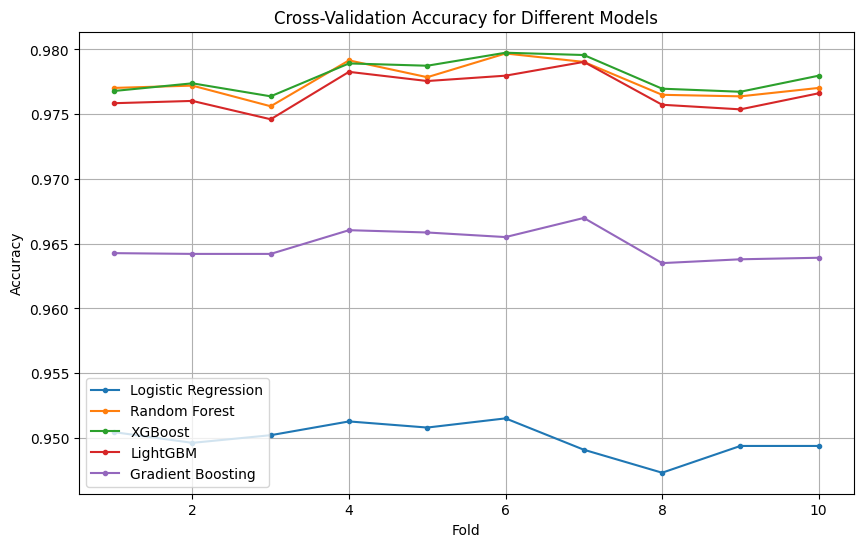

In [ ]:

plt.figure(figsize=(10, 6))
for model in cv_scores['model'].unique():
    model_scores = cv_scores[cv_scores['model'] == model]['accuracy']
    plt.plot(range(1, len(model_scores) + 1), model_scores, marker='.', linestyle='-', label=model)

plt.title('Cross-Validation Accuracy for Different Models')
plt.xlabel('Fold')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

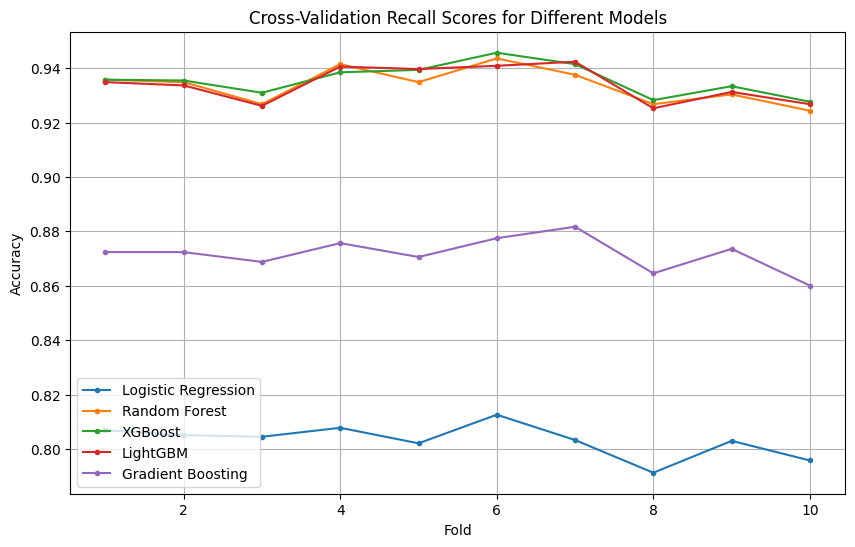

In [ ]:
##RECALL
plt.figure(figsize=(10, 6))
for model in cv_scores['model'][:50].unique():
    model_scores = cv_scores[cv_scores['model'] == model]['recall'][:50]
    plt.plot(range(1, len(model_scores) + 1), model_scores, marker='.', linestyle='-', label=model)

plt.title('Cross-Validation Recall Scores for Different Models')
plt.xlabel('Fold')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
df_time_to_predict = df_time_to_predict.sort_values(by='time', ascending=True)
df_time_to_predict

,model,time
2,XGBoost,11.04
0,Logistic Regression,15.37
3,LightGBM,18.30
4,Gradient Boosting,163.88
1,Random Forest,464.21


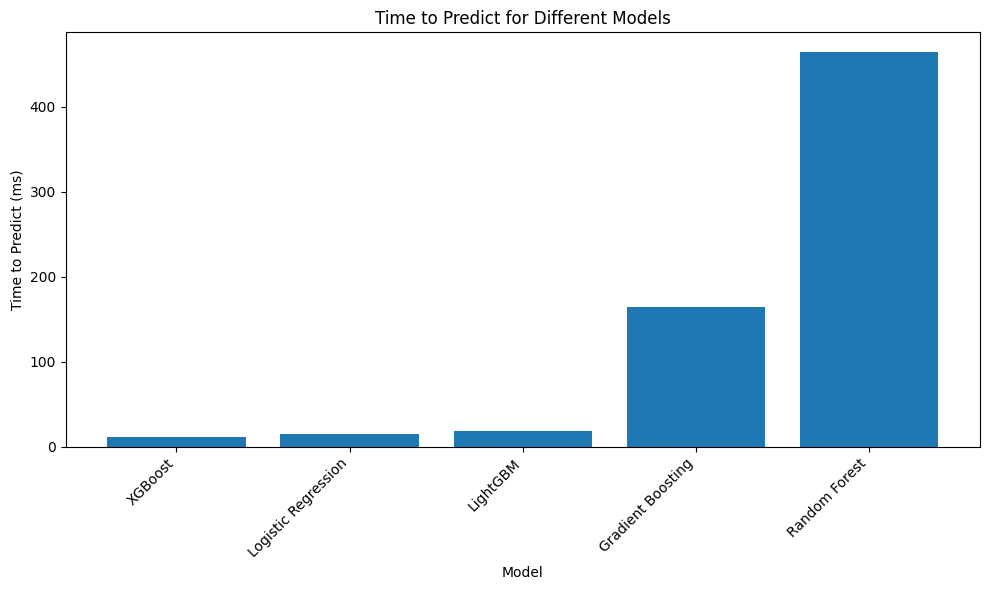

In [ ]:
plt.figure(figsize=(10, 6))
plt.bar(df_time_to_predict['model'], df_time_to_predict['time'])
plt.xlabel("Model")
plt.ylabel("Time to Predict (ms)")
plt.title("Time to Predict for Different Models")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

### TRAINING AND BEST MODEL SELECTION - SESSION 2- BALANCED DATASET


In [ ]:
"""### BASE BALANCEADA"""

from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import RandomOverSampler

rus = RandomUnderSampler(random_state=42, sampling_strategy = 'majority')
X_resampled, y_resampled = rus.fit_resample(X_train, y_train)


#ros = RandomOverSampler(random_state=42, sampling_strategy='minority')
#X_resampled, y_resampled = ros.fit_resample(X_train, y_train)


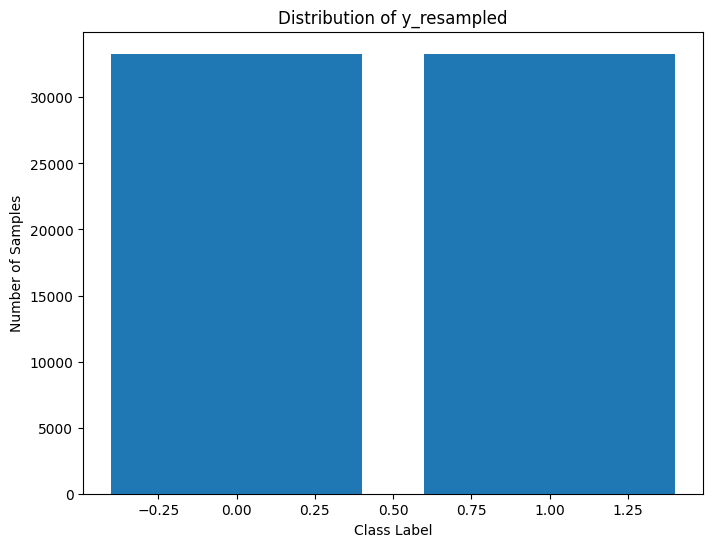

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


y_resampled_df = pd.DataFrame({'y_resampled': y_resampled})
value_counts = y_resampled_df['y_resampled'].value_counts()

# Create the bar plot
plt.figure(figsize=(8, 6))
plt.bar(value_counts.index, value_counts.values)
plt.xlabel("Class Label")
plt.ylabel("Number of Samples")
plt.title("Distribution of y_resampled")
plt.show()

In [ ]:
####REGRESSAO LOGISTICA
model_name = 'Logistic Regression Balanced'
pipe_lr = make_pipeline(StandardScaler(), LogisticRegression( random_state=42))
pipe_lr.fit(X_resampled, y_resampled)
pipe_lr.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_lr, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_lr, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_lr_2 = pipe_lr.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
####Random Forest
model_name = 'Random Forest Balanced'
pipe_rf = make_pipeline(StandardScaler(), RandomForestClassifier( random_state=42))
pipe_rf.fit(X_resampled, y_resampled)
pipe_rf.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_rf, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'recall', n_jobs = -1)
accuracy = cross_val_score(estimator = pipe_rf, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'accuracy', n_jobs = -1)

start_time = time.time()
y_pred_rf_2 = pipe_rf.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
####XGBoost
model_name = 'XGBoost balanced'
pipe_xgb = make_pipeline(StandardScaler(), xgb.XGBClassifier( random_state=42))
pipe_xgb.fit(X_resampled, y_resampled)
pipe_xgb.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_xgb, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'recall')
accuracy  = cross_val_score(estimator = pipe_xgb, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_xgb_2 = pipe_xgb.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
####LGBM
model_name = 'LGBM balanced'
pipe_lgbm = make_pipeline(StandardScaler(),  LGBMClassifier(boosting_type= 'gbdt', random_state=42))
pipe_lgbm.fit(X_train, y_train)
pipe_lgbm.fit(X_resampled, y_resampled)
pipe_lgbm.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_lgbm, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_lgbm, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_lgbm_2 = pipe_lgbm.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[LightGBM] [Info] Number of positive: 33300, number of negative: 136027
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004167 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 989
[LightGBM] [Info] Number of data points in the train set: 169327, number of used features: 20
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.196661 -> initscore=-1.407296
[LightGBM] [Info] Start training from score -1.407296
[LightGBM] [Info] Number of positive: 33300, number of negative: 33300
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002191 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 957
[LightGBM] [Info] Number of data points in the train set: 66600, number of used features: 19
[LightGBM] [Info] 

In [ ]:
"""GRADIENT BOOSTING"""

model_name = 'Gradient Boosting balanced'
pipe_gbc_bal = make_pipeline(StandardScaler(), GradientBoostingClassifier(max_features='sqrt',random_state=42))
pipe_gbc_bal.fit(X_resampled, y_resampled)
pipe_gbc_bal.score(X_test, y_test)

recall = cross_val_score(estimator = pipe_gbc_bal, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'recall')
accuracy = cross_val_score(estimator = pipe_gbc_bal, X = X_resampled, y = y_resampled.values.flatten(), cv = 10, scoring = 'accuracy')

start_time = time.time()
y_pred_gbc_2 = pipe_gbc_bal.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000

nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

In [ ]:
"""RESULTADOS"""
df_nfold_results = pd.DataFrame(nfold_results)
cv_scores2 = df_nfold_results.explode(['recall', 'accuracy'])
cv_scores = pd.concat([cv_scores,cv_scores2])
df_temp =pd.DataFrame(time_to_predict)
df_time_to_predict = pd.concat([df_time_to_predict,df_temp])


In [ ]:
time_to_predict

[{'model': 'Logistic Regression', 'time': 15.36870002746582},
 {'model': 'Random Forest', 'time': 464.21051025390625},
 {'model': 'XGBoost', 'time': 11.044025421142578},
 {'model': 'LightGBM', 'time': 18.301010131835938},
 {'model': 'Gradient Boosting', 'time': 163.88249397277832},
 {'model': 'Logistic Regression Balanced', 'time': 29.185771942138672},
 {'model': 'Random Forest Balanced', 'time': 937.5786781311035},
 {'model': 'XGBoost balanced', 'time': 19.194841384887695},
 {'model': 'LGBM balanced', 'time': 33.661842346191406},
 {'model': 'Gradient Boosting balanced', 'time': 78.48548889160156}]

In [ ]:
cv_scores2

,model,recall,accuracy
0,Logistic Regression,0.81,0.95
0,Logistic Regression,0.81,0.95
0,Logistic Regression,0.80,0.95
0,Logistic Regression,0.81,0.95
0,Logistic Regression,0.80,0.95
0,Logistic Regression,0.81,0.95
0,Logistic Regression,0.80,0.95
0,Logistic Regression,0.79,0.95
0,Logistic Regression,0.80,0.95
0,Logistic Regression,0.80,0.95


In [ ]:
cv_scores2 = cv_scores2[50:]

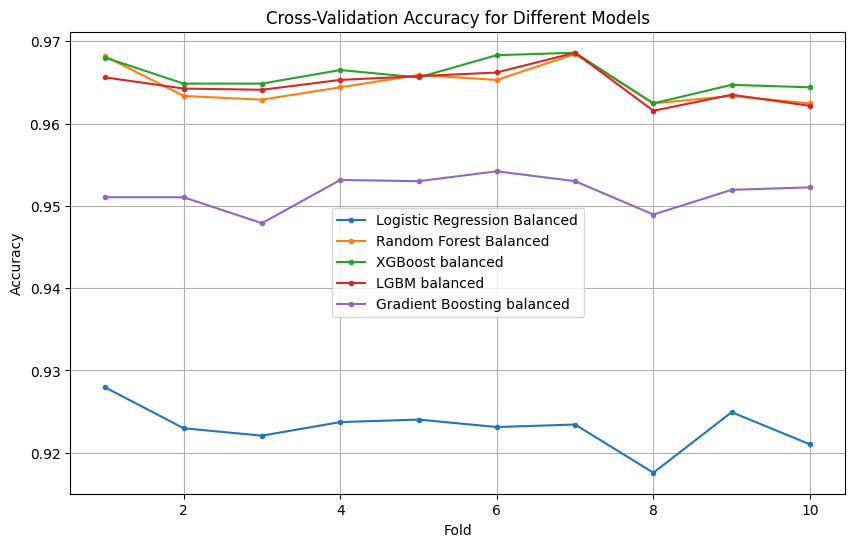

In [ ]:
##ACCURACY
plt.figure(figsize=(10, 6))
for model in cv_scores2['model'].unique():
    model_scores = cv_scores2[cv_scores2['model'] == model]['accuracy']
    plt.plot(range(1, len(model_scores) + 1), model_scores, marker='.', linestyle='-', label=model)

plt.title('Cross-Validation Accuracy for Different Models')
plt.xlabel('Fold')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

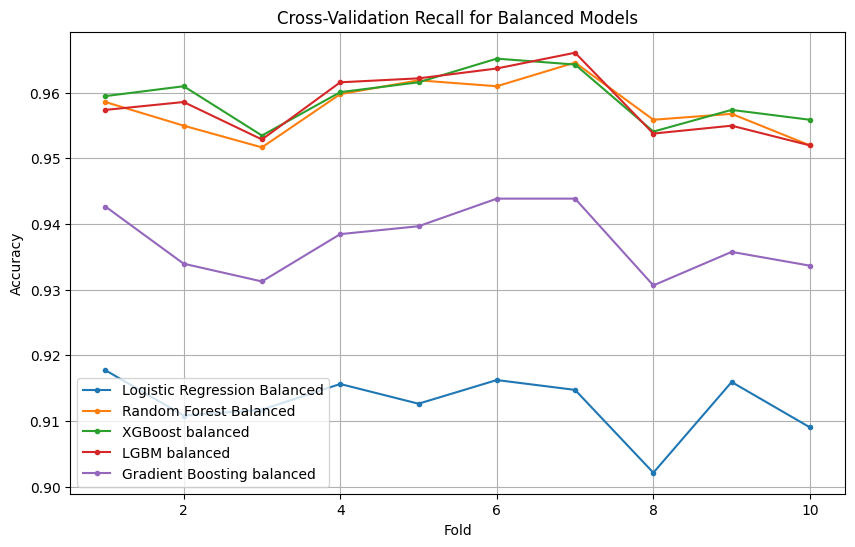

In [ ]:
##RECALL
plt.figure(figsize=(10, 6))
for model in cv_scores2['model'].unique():
    model_scores = cv_scores2[cv_scores2['model'] == model]['recall']
    plt.plot(range(1, len(model_scores) + 1), model_scores, marker='.', linestyle='-', label=model)

plt.title('Cross-Validation Recall for Balanced Models')
plt.xlabel('Fold')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

In [ ]:
cv_scores.to_csv(path_source_code+"train_cv_scores.csv")
df_time_to_predict.to_csv(path_source_code+"time_to_predict.csv")

In [ ]:
mean_accuracy_by_model = cv_scores.groupby('model')['accuracy'].mean()*100
mean_recall_by_model = cv_scores.groupby('model')['recall'].mean()*100

In [ ]:
mean_accuracy_by_model.sort_values()

model
Logistic Regression Balanced   92.31
Logistic Regression            94.99
Gradient Boosting balanced     95.17
Random Forest Balanced         96.47
LGBM balanced                  96.47
Gradient Boosting              96.48
XGBoost balanced               96.58
LightGBM                       97.67
Random Forest                  97.75
XGBoost                        97.79
Name: accuracy, dtype: object

In [ ]:
mean_recall_by_model.sort_values()

model
Logistic Regression            80.32
Gradient Boosting              87.17
Logistic Regression Balanced   91.26
Random Forest                  93.36
LightGBM                       93.41
XGBoost                        93.56
Gradient Boosting balanced     93.74
Random Forest Balanced         95.77
LGBM balanced                  95.83
XGBoost balanced               95.92
Name: recall, dtype: object

In [ ]:
def custom_scorer(y_true, y_pred):
    recall = recall_score(y_true, y_pred)
    accuracy = accuracy_score(y_true, y_pred)
    return 0.5 * recall + 0.5 * accuracy  # Example: Equal weight to recall and accuracy
scorer = make_scorer(custom_scorer)

In [ ]:
test_result = pd.DataFrame()

In [ ]:
### RANDOMFOREST HYPERPARAMETRING
model_name = 'Random Forest Best Model'
pipe_rf_bal = Pipeline([('scaler', StandardScaler()), ('rfc',RandomForestClassifier(random_state = 42))])
pipe_rf_bal.fit(X_resampled, y_resampled)
scoring = ['accuracy', 'precision']


# Create RandomizedSearchCV with custom scorer
rf_random_search = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_rf_bal,
    param_distributions=params_grid_rf,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
rf_random_search.fit(X_resampled, y_resampled)
cv_results = rf_random_search.cv_results_
print(cv_results['mean_test_score'])


#Test RandomForest Best Model
start_time = time.time()
y_pred_rf_bal_best = rf_random_search.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_rf_bal_best)*100,
    'Accuracy': accuracy_score(y_test, y_pred_rf_bal_best)*100,
    'Precision': precision_score(y_test, y_pred_rf_bal_best)*100,
    'F1-score': f1_score(y_test, y_pred_rf_bal_best)*100,
})


test_result = pd.concat([test_result,result ])
print(result)
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[0.92855856 0.95257508 0.92837087 0.95280781 0.96144895 0.95369369
 0.92598348 0.95361862 0.96063814 0.92608859]
                      Model  Recall  Accuracy  Precision  F1-score
0  Random Forest Best Model   95.71     97.15      90.37     92.96


In [ ]:
rf_random_search

RandomizedSearchCV(cv=10,
                   estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                             ('rfc',
                                              RandomForestClassifier(random_state=42))]),
                   n_jobs=-1,
                   param_distributions={'rfc__criterion': ['gini', 'entropy'],
                                        'rfc__max_depth': [None, 5, 10, 20],
                                        'rfc__max_features': [None, 'sqrt',
                                                              'log2'],
                                        'rfc__min_samples_leaf': [1, 2, 4],
                                        'rfc__min_samples_split': [2, 5, 10],
                                        'rfc__n_estimators': [50, 100, 200,
                                                              300]},
                   random_state=42,
                   scoring=make_scorer(custom_scorer, response_method='predict'))

In [ ]:
rf_random_search.best_params_

{'rfc__n_estimators': 300,
 'rfc__min_samples_split': 10,
 'rfc__min_samples_leaf': 2,
 'rfc__max_features': None,
 'rfc__max_depth': None,
 'rfc__criterion': 'gini'}

In [ ]:
test_result

,Model,Recall,Accuracy,Precision,F1-score
0,Random Forest Best Model,95.71,97.15,90.37,92.96


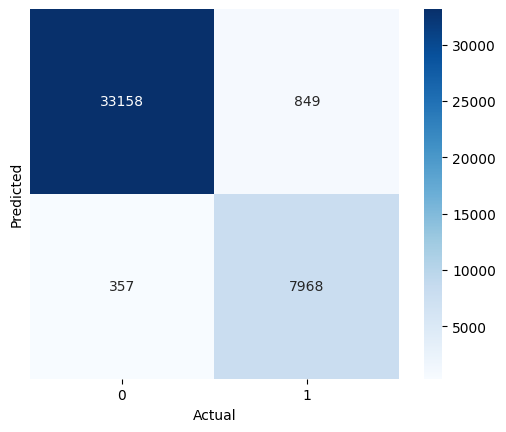

In [ ]:
"""MATRIZ DE CONFUSAO"""

confusion_matrix = metrics.confusion_matrix(y_test, y_pred_rf_bal_best)
ax = seaborn.heatmap(confusion_matrix, xticklabels=1, yticklabels=0, annot=True, square=True, cmap='Blues', fmt=".0f")
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

In [ ]:
sum(y_test)


8325.0

In [ ]:
### XGBOOST HYPERPARAMETRING
model_name = 'XGBoost Best Model'
pipe_xgb_bal = Pipeline([('scaler', StandardScaler()), ('xgb',xgb.XGBClassifier(random_state = 42))])
pipe_xgb_bal.fit(X_resampled, y_resampled.values.flatten())



xgb_random_search = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_xgb_bal,
    param_distributions=param_grid_xgb,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
xgb_random_search.fit(X_resampled, y_resampled)

cv_results = xgb_random_search.cv_results_
print(cv_results['mean_test_score'])


#TEST
pipe_xgb_bal = Pipeline([('scaler', StandardScaler()), ('xgb',xgb_random_search)])
pipe_xgb_bal.fit(X_resampled, y_resampled.values.flatten())

model_name = 'XGBoost Best Model'
start_time = time.time()
y_pred_xgb_bal_best = pipe_xgb_bal.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_xgb_bal_best)*100,
    'Accuracy': accuracy_score(y_test, y_pred_xgb_bal_best)*100,
    'Precision': precision_score(y_test, y_pred_xgb_bal_best)*100,
    'F1-score': f1_score(y_test, y_pred_xgb_bal_best)*100,
})


test_result = pd.concat([test_result,result ])
print(result)
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[0.9301952  0.93276276 0.94031532 0.93281532 0.95164414 0.9623048
 0.94586336 0.9512988  0.9306982  0.93281532]
                Model  Recall  Accuracy  Precision  F1-score
0  XGBoost Best Model   95.69     97.16      90.43     92.98


In [ ]:
xgb_random_search.best_score_

np.float64(0.9623048048048048)

##Testing best models

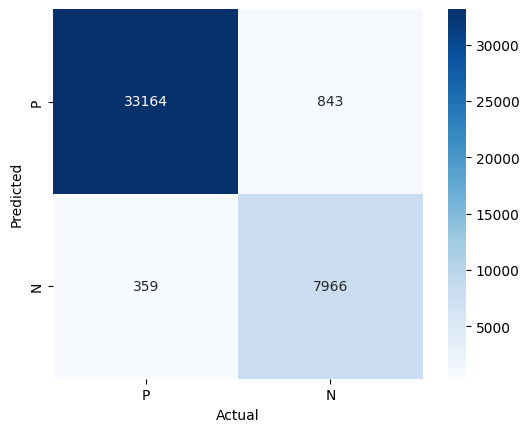

In [ ]:
"""MATRIZ DE CONFUSAO"""

confusion_matrix = metrics.confusion_matrix(y_test, y_pred_xgb_bal_best)
ax = seaborn.heatmap(confusion_matrix, xticklabels='PN', yticklabels='PN', annot=True, square=True, cmap='Blues', fmt=".0f")
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

In [ ]:
cv_scores.to_csv(path_source_code+"test_result.csv")
df_time_to_predict.to_csv(path_source_code+"time_to_predict.csv")

In [ ]:
pipe_lgbm = Pipeline([
    ('scaler', StandardScaler()),
    ('lgbm', LGBMClassifier(objective='binary'))
])

# Create the RandomizedSearchCV object
random_search_lgbm = RandomizedSearchCV(
    estimator=pipe_lgbm,
    param_distributions=params_grid_lgbm,
    n_iter=10,  # Number of parameter settings to try
    cv=10,  # Number of cross-validation folds
    scoring=scorer,  # Replace with your desired metric
    verbose=2,
    random_state=42  # For reproducibility
)

# Perform randomized search
random_search_lgbm.fit(X_train, y_train)

# Print the best parameters
print("Best parameters found: ", random_search_lgbm.best_params_)

# Evaluate the best model (optional)
best_model = random_search_lgbm.best_estimator_


#TEST
#pipe_lgbm_bal = Pipeline([('scaler', StandardScaler()), ('lgbm',random_search_lgbm)])
best_model.fit(X_resampled, y_resampled.values.flatten())

model_name = 'LBGM Best Model'
start_time = time.time()
y_pred_lgbm_bal_best = best_model.predict(X_test)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_lgbm_bal_best)*100,
    'Accuracy': accuracy_score(y_test, y_pred_lgbm_bal_best)*100,
    'Precision': precision_score(y_test, y_pred_lgbm_bal_best)*100,
    'F1-score': f1_score(y_test, y_pred_lgbm_bal_best)*100,
})


test_result = pd.concat([test_result,result ])
print(result)


Fitting 10 folds for each of 10 candidates, totalling 100 fits
[LightGBM] [Info] Number of positive: 29970, number of negative: 122424
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002330 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 978
[LightGBM] [Info] Number of data points in the train set: 152394, number of used features: 19
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.196661 -> initscore=-1.407294
[LightGBM] [Info] Start training from score -1.407294
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li


####Feature Reduction Analysis

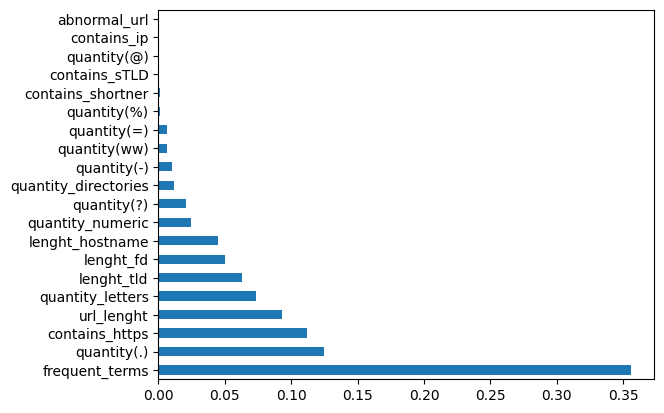

In [ ]:
modelo = RandomForestClassifier(random_state = 42)
modelo.fit(X_resampled, y_resampled)
feat_importances = pd.Series(modelo.feature_importances_, index=X_resampled.columns)
feat_importances.nlargest(25).plot(kind='barh')
plt.show()

In [ ]:
feat_importances.sort_values()*100

abnormal_url            0.01
contains_ip             0.02
quantity(@)             0.03
contains_sTLD           0.04
contains_shortner       0.09
quantity(%)             0.15
quantity(=)             0.64
quantity(ww)            0.68
quantity(-)             1.04
quantity_directories    1.14
quantity(?)             2.06
quantity_numeric        2.46
lenght_hostname         4.50
lenght_fd               5.03
lenght_tld              6.28
quantity_letters        7.36
url_lenght              9.29
contains_https         11.16
quantity(.)            12.47
frequent_terms         35.58
dtype: float64

[LightGBM] [Info] Number of positive: 33300, number of negative: 33300
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001424 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 941
[LightGBM] [Info] Number of data points in the train set: 66600, number of used features: 19
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000


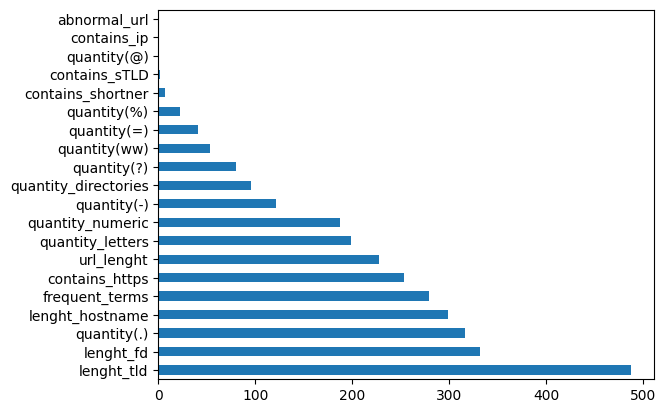

In [ ]:
modelo = LGBMClassifier(random_state = 42)
modelo.fit(X_resampled, y_resampled)
feat_importances = pd.Series(modelo.feature_importances_, index=X_resampled.columns)
feat_importances.nlargest(25).plot(kind='barh')
plt.show()

In [ ]:
feat_importances.sort_values()

abnormal_url              0
quantity(@)               1
contains_ip               1
contains_sTLD             2
contains_shortner         7
quantity(%)              22
quantity(=)              41
quantity(ww)             53
quantity(?)              80
quantity_directories     95
quantity(-)             121
quantity_numeric        187
quantity_letters        198
url_lenght              227
contains_https          253
frequent_terms          279
lenght_hostname         299
quantity(.)             316
lenght_fd               331
lenght_tld              487
dtype: int32

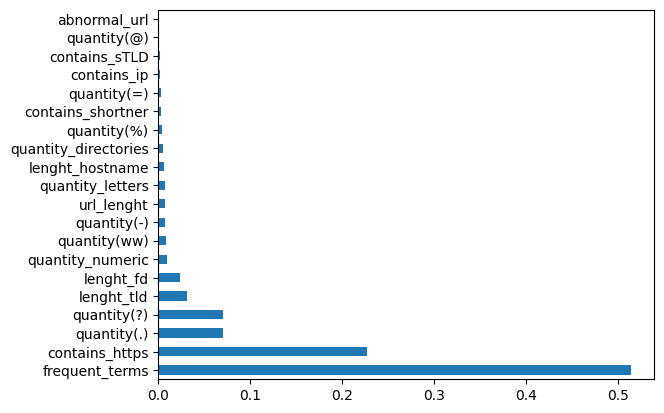

In [ ]:
modelo = xgb.XGBClassifier(random_state = 42)
modelo.fit(X_resampled, y_resampled)
feat_importances = pd.Series(modelo.feature_importances_, index=X_train.columns)
feat_importances.nlargest(25).plot(kind='barh')
plt.show()

In [ ]:
feat_importances.sort_values()

abnormal_url           0.00
quantity(@)            0.00
contains_sTLD          0.00
contains_ip            0.00
quantity(=)            0.00
contains_shortner      0.00
quantity(%)            0.00
quantity_directories   0.01
lenght_hostname        0.01
quantity_letters       0.01
url_lenght             0.01
quantity(-)            0.01
quantity(ww)           0.01
quantity_numeric       0.01
lenght_fd              0.02
lenght_tld             0.03
quantity(?)            0.07
quantity(.)            0.07
contains_https         0.23
frequent_terms         0.51
dtype: float32

In [ ]:
corr = X_resampled.corr()
corr.style.background_gradient(cmap='coolwarm').format(precision=2)

,frequent_terms,contains_sTLD,abnormal_url,quantity(.),quantity(ww),quantity(@),quantity(%),quantity(?),quantity(-),quantity(=),url_lenght,lenght_hostname,contains_ip,quantity_directories,contains_shortner,lenght_fd,lenght_tld,quantity_numeric,quantity_letters,contains_https
frequent_terms,1.00,-0.01,0.00,0.36,0.32,0.04,0.14,0.31,0.39,0.25,0.47,0.44,-0.04,0.30,-0.04,0.35,0.17,0.28,0.47,-0.12
contains_sTLD,-0.01,1.00,0.00,0.02,0.03,-0.00,0.00,-0.01,-0.01,-0.01,-0.00,-0.02,-0.00,0.02,-0.00,-0.01,0.01,-0.01,0.00,0.00
abnormal_url,0.00,0.00,1.00,-0.01,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.02,0.00,0.00,0.00,0.00,0.02,-0.01,-0.00,-0.01
quantity(.),0.36,0.02,-0.01,1.00,0.14,0.11,0.26,0.24,0.27,0.28,0.47,0.51,0.09,0.29,-0.04,0.18,0.04,0.35,0.42,0.05
quantity(ww),0.32,0.03,-0.00,0.14,1.00,0.00,0.00,0.02,0.06,0.02,0.10,0.09,-0.01,0.12,-0.01,0.12,-0.00,0.02,0.11,-0.02
quantity(@),0.04,-0.00,0.00,0.11,0.00,1.00,0.18,0.15,0.20,0.28,0.25,0.01,0.01,0.04,-0.00,0.01,0.12,0.16,0.24,-0.00
quantity(%),0.14,0.00,0.00,0.26,0.00,0.18,1.00,0.22,0.17,0.39,0.49,0.05,0.00,0.03,-0.01,0.04,0.00,0.45,0.42,-0.02
quantity(?),0.31,-0.01,-0.00,0.24,0.02,0.15,0.22,1.00,0.17,0.61,0.62,0.01,-0.01,0.12,-0.00,0.25,0.08,0.55,0.56,-0.04
quantity(-),0.39,-0.01,-0.00,0.27,0.06,0.20,0.17,0.17,1.00,0.38,0.43,0.37,-0.01,0.24,-0.02,0.24,0.19,0.32,0.39,0.04
quantity(=),0.25,-0.01,-0.00,0.28,0.02,0.28,0.39,0.61,0.38,1.00,0.64,0.02,0.01,0.10,-0.00,0.17,0.12,0.60,0.56,0.01


#### Feature Selection Approach

In [ ]:
model_name = 'Random Forest FS(median)'

pipeline_rf_fs = Pipeline([
    ('scaler', StandardScaler()),
    ('feature_selection', SelectFromModel(RandomForestClassifier(random_state=42, n_estimators=100), prefit=False)),
    ('rfc', RandomForestClassifier(random_state=42))
])

# --- Parameter grid for RandomizedSearchCV ---
param_distributions = {
    'feature_selection__threshold': ['mean', 'median'],
    'feature_selection__estimator__n_estimators': [50, 100, 150],
    'rfc__n_estimators': [50,100, 200, 300],
    'rfc__criterion': ['gini', 'entropy'],
    'rfc__max_depth': [None, 5, 10, 20],
    'rfc__min_samples_split': [2, 5, 10],
    'rfc__min_samples_leaf': [1, 2, 4],
    'rfc__max_features': [None,'sqrt', 'log2']
}

# Scoring
scorer = make_scorer(f1_score)

# --- Run RandomizedSearchCV ---
random_search = RandomizedSearchCV(
    estimator=pipeline_rf_fs,
    param_distributions=param_distributions,
    n_iter=10,
    cv=5,
    scoring=scorer,
    n_jobs=-1,
    verbose=2,
    random_state=42
)

print("Starting RandomizedSearchCV...")
random_search.fit(X_resampled, y_resampled)
print("RandomizedSearchCV complete.")

# --- Best results ---
print("\nBest parameters found by RandomizedSearchCV:")
print(random_search.best_params_)

print("\nBest cross-validation score:")
print(f"{random_search.best_score_:.4f}")

# Best pipeline and predictions
best_pipeline = random_search.best_estimator_
y_pred_best = best_pipeline.predict(X_test)
y_pred_proba_best = best_pipeline.predict_proba(X_test)[:, 1]

print(f"\nTest set F1-score with best pipeline: {f1_score(y_test, y_pred_best):.4f}")
print(f"Test set ROC AUC with best pipeline: {roc_auc_score(y_test, y_pred_proba_best):.4f}")
print(f"Test set Accuracy with best pipeline: {accuracy_score(y_test, y_pred_best):.4f}")

# --- Feature selection details ---
fitted_feature_selector_best = best_pipeline.named_steps['feature_selection']
selected_features_mask_best = fitted_feature_selector_best.get_support()
selected_feature_names_best = X_resampled.columns[selected_features_mask_best]
print(f"\nNumber of features selected by best pipeline: {len(selected_feature_names_best)}")
print(f"Selected features by best pipeline: {selected_feature_names_best.to_list()}")

# --- Summary of all trials ---
results_df = pd.DataFrame(random_search.cv_results_)
results_df_sorted = results_df.sort_values(by='mean_test_score', ascending=False)

display_cols = [
    'param_feature_selection__threshold',
    'param_rfc__n_estimators',
    'param_rfc__max_depth',
    'mean_test_score',
    'std_test_score',
    'rank_test_score'
]
print("\n--- All RandomizedSearchCV Results (Top 5) ---")
print(results_df_sorted[display_cols].head().round(4).to_string())

result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_best)*100,
    'Accuracy': accuracy_score(y_test, y_pred_best)*100,
    'Precision': precision_score(y_test, y_pred_best)*100,
    'F1-score': f1_score(y_test, y_pred_best)*100,
})

test_result = pd.concat([test_result,result ])
print(result)

In [ ]:
model_name = 'XGB FS(median)'


pipeline_xgb_fs = Pipeline([
    ('scaler', StandardScaler()),
    ('feature_selection', SelectFromModel(XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'), prefit=False)),
    ('xgb', XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss'))
])


# Define hyperparameter search space
param_grid_xgb2 = {
    'feature_selection__threshold': ['mean', 'median'],
    'feature_selection__estimator__n_estimators': [50, 100, 150],
    'xgb__n_estimators': [50, 100, 200, 300],
    'xgb__learning_rate': [0.001, 0.01, 0.05, 0.1],
    'xgb__max_depth': [5, 10, 20, 30],
    'xgb__min_child_weight': [20, 50, 100],
    'xgb__reg_alpha': [0, 0.1, 0.5, 1],
    'xgb__reg_lambda': [0, 0.1, 0.5, 1]
}

# Use F1-score for scoring
scorer = make_scorer(f1_score)

# Run RandomizedSearchCV
random_search = RandomizedSearchCV(
    estimator=pipeline_xgb_fs,
    param_distributions=param_grid_xgb2,
    n_iter=12,
    cv=5,
    scoring=scorer,
    n_jobs=-1,
    verbose=2,
    random_state=42
)

print("Starting RandomizedSearchCV...")
random_search.fit(X_resampled, y_resampled)
print("RandomizedSearchCV complete.")

# Best result summary
print("\nBest parameters found by RandomizedSearchCV:")
print(random_search.best_params_)

print("\nBest cross-validation score:")
print(f"{random_search.best_score_:.4f}")

# Evaluate on test set
best_pipeline = random_search.best_estimator_
y_pred_best = best_pipeline.predict(X_test)
y_pred_proba_best = best_pipeline.predict_proba(X_test)[:, 1]

print(f"\nTest set F1-score with best pipeline: {f1_score(y_test, y_pred_best):.4f}")
print(f"Test set ROC AUC: {roc_auc_score(y_test, y_pred_proba_best):.4f}")
print(f"Test set Accuracy: {accuracy_score(y_test, y_pred_best):.4f}")

# Show selected features
fitted_feature_selector_best = best_pipeline.named_steps['feature_selection']
selected_features_mask_best = fitted_feature_selector_best.get_support()
selected_feature_names_best = X_resampled.columns[selected_features_mask_best]
print(f"\nNumber of features selected: {len(selected_feature_names_best)}")
print(f"Selected features: {selected_feature_names_best.to_list()}")

# Results DataFrame
results_df = pd.DataFrame(random_search.cv_results_)
results_df_sorted = results_df.sort_values(by='mean_test_score', ascending=False)

# Display summary
display_cols = [
    'param_feature_selection__threshold',
    'param_xgb__n_estimators',
    'param_xgb__learning_rate',
    'param_xgb__max_depth',
    'mean_test_score',
    'std_test_score',
    'rank_test_score'
]
print("\n--- Top 5 RandomizedSearchCV Results ---")
print(results_df_sorted[display_cols].head().round(4).to_string())


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_best)*100,
    'Accuracy': accuracy_score(y_test, y_pred_best)*100,
    'Precision': precision_score(y_test, y_pred_best)*100,
    'F1-score': f1_score(y_test, y_pred_best)*100,
})

test_result = pd.concat([test_result,result ])
print(result)

In [ ]:
model_name = 'LGBM FS(median)'


pipeline_lgbm_fs = Pipeline([
    ('scaler', StandardScaler()),
    ('feature_selection', SelectFromModel(LGBMClassifier(random_state=42), prefit=False)),
    ('lgbm', LGBMClassifier(random_state=42))
])

# --- 3. Define the parameter grid for RandomizedSearchCV ---
param_grid_lgbm2 = {
    'feature_selection__threshold': ['mean', 'median'],
    'feature_selection__estimator__n_estimators': [50, 100],
    'lgbm__n_estimators': [50, 100, 200, 300],
    'lgbm__learning_rate': [0.001, 0.01, 0.05, 0.1],
    'lgbm__num_leaves': [30, 50, 70, 90],
    'lgbm__max_depth': [4, 6,8, 10],
    'lgbm__min_child_samples': [20, 50, 100],
    'lgbm__reg_alpha': [0, 0.1, 0.5, 1],
    'lgbm__reg_lambda': [0, 0.1, 0.5, 1]
}

# --- 4. Define your scoring metric ---
# Make a scorer for f1_score if that's your primary metric
scorer = make_scorer(f1_score) # You can also pass a list of scorers if needed

# --- 5. Initialize and run RandomizedSearchCV ---
random_search = RandomizedSearchCV(
    estimator=pipeline_lgbm_fs,
    param_distributions=param_grid_lgbm2,
    n_iter=10, # Number of different parameter combinations to sample. Adjust this based on your budget.
    cv=5, # Number of cross-validation folds
    scoring=scorer,
    n_jobs=-1, # Use all available cores
    verbose=2, # To see detailed progress
    random_state=42 # For reproducibility of random sampling
)

print("Starting RandomizedSearchCV...")
random_search.fit(X_resampled, y_resampled) # Fit on your training data (X_resampled)
print("RandomizedSearchCV complete.")

# --- 6. Access the best results ---
print("\nBest parameters found by RandomizedSearchCV:")
print(random_search.best_params_)

print("\nBest cross-validation score:")
print(f"{random_search.best_score_:.4f}")

# Get the best performing pipeline
best_pipeline = random_search.best_estimator_
print("\nBest pipeline (fitted with best parameters):")
print(best_pipeline)

# You can now use best_pipeline to make predictions on the unseen test set
y_pred_best = best_pipeline.predict(X_test)
y_pred_proba_best = best_pipeline.predict_proba(X_test)[:, 1]

print(f"\nTest set F1-score with best pipeline: {f1_score(y_test, y_pred_best):.4f}")
print(f"Test set ROC AUC with best pipeline: {roc_auc_score(y_test, y_pred_proba_best):.4f}")
print(f"Test set Accuracy with best pipeline: {accuracy_score(y_test, y_pred_best):.4f}")

# --- Optional: Get details about selected features for the best model ---
# To get the names of selected features from the best pipeline:
fitted_feature_selector_best = best_pipeline.named_steps['feature_selection']
selected_features_mask_best = fitted_feature_selector_best.get_support()
selected_feature_names_best = X_resampled.columns[selected_features_mask_best]
print(f"\nNumber of features selected by best pipeline: {len(selected_feature_names_best)}")
print(f"Selected features by best pipeline: {selected_feature_names_best.to_list()}")

# --- Accessing all results from RandomizedSearchCV ---
# This DataFrame contains all the results for each sampled combination
results_df = pd.DataFrame(random_search.cv_results_)
# Sort by mean test score to see the top performers
results_df_sorted = results_df.sort_values(by='mean_test_score', ascending=False)
print("\n--- All RandomizedSearchCV Results (Top 5) ---")
# Select relevant columns for display
display_cols = [
    'param_feature_selection__threshold',
    'param_classifier__n_estimators',
    'param_classifier__learning_rate',
    'mean_test_score',
    'std_test_score',
    'rank_test_score'
]
print(results_df_sorted[display_cols].head().round(4).to_string())


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_best)*100,
    'Accuracy': accuracy_score(y_test, y_pred_best)*100,
    'Precision': precision_score(y_test, y_pred_best)*100,
    'F1-score': f1_score(y_test, y_pred_best)*100,
})

test_result = pd.concat([test_result,result ])
print(result)


Starting RandomizedSearchCV...
Fitting 5 folds for each of 10 candidates, totalling 50 fits


In [ ]:
best_pipeline


Pipeline(steps=[('scaler', StandardScaler()),
                ('feature_selection',
                 SelectFromModel(estimator=LGBMClassifier(random_state=42),
                                 threshold='median')),
                ('classifier',
                 LGBMClassifier(learning_rate=0.2, n_estimators=200,
                                random_state=42))])

In [ ]:
corr = X_resampled[selected_feature_names].corr()
corr.style.background_gradient(cmap='coolwarm').format(precision=2)

,frequent_terms,quantity(.),quantity(?),url_lenght,lenght_hostname,lenght_fd,lenght_tld,quantity_numeric,quantity_letters,contains_https
frequent_terms,1.00,0.36,0.31,0.47,0.44,0.35,0.17,0.28,0.47,-0.12
quantity(.),0.36,1.00,0.24,0.47,0.51,0.18,0.04,0.35,0.42,0.05
quantity(?),0.31,0.24,1.00,0.62,0.01,0.25,0.08,0.55,0.56,-0.04
url_lenght,0.47,0.47,0.62,1.00,0.30,0.42,0.18,0.77,0.96,0.07
lenght_hostname,0.44,0.51,0.01,0.30,1.00,0.11,0.32,0.11,0.33,0.13
lenght_fd,0.35,0.18,0.25,0.42,0.11,1.00,0.00,0.40,0.38,0.02
lenght_tld,0.17,0.04,0.08,0.18,0.32,0.00,1.00,0.06,0.20,0.25
quantity_numeric,0.28,0.35,0.55,0.77,0.11,0.40,0.06,1.00,0.59,0.00
quantity_letters,0.47,0.42,0.56,0.96,0.33,0.38,0.20,0.59,1.00,0.08
contains_https,-0.12,0.05,-0.04,0.07,0.13,0.02,0.25,0.00,0.08,1.00


In [ ]:
test_result

,Model,Recall,Accuracy,Precision,F1-score
0,Random Forest Best Model,95.71,97.16,90.40,92.98
0,XGBoost Best Model,95.82,97.31,91.00,93.35
0,LBGM Best Model,96.02,97.28,90.69,93.28
0,Random Forest FS(median),91.95,95.41,85.72,88.73
0,LightGBM FS(median),93.91,95.20,83.67,88.49
0,XGBoost FS(median),93.09,96.01,87.42,90.17


In [ ]:
nfold_results

[{'model': 'Logistic Regression',
  'recall': array([0.80690691, 0.80510511, 0.8045045 , 0.80780781, 0.8021021 ,
         0.81261261, 0.8033033 , 0.79129129, 0.803003  , 0.7957958 ]),
  'accuracy': array([0.95045178, 0.94962499, 0.95021556, 0.95127857, 0.95080612,
         0.95151479, 0.94909349, 0.94731869, 0.94938578, 0.94938578])},
 {'model': 'Random Forest',
  'recall': array([0.93573574, 0.93483483, 0.92672673, 0.94144144, 0.93483483,
         0.94354354, 0.93753754, 0.92672673, 0.93033033, 0.92432432]),
  'accuracy': array([0.97702711, 0.97720428, 0.97560976, 0.97915313, 0.97785389,
         0.97968464, 0.97903502, 0.97649421, 0.97637609, 0.97702575])},
 {'model': 'XGBoost',
  'recall': array([0.93573574, 0.93543544, 0.93093093, 0.93843844, 0.93933934,
         0.94564565, 0.94144144, 0.92822823, 0.93333333, 0.92762763]),
  'accuracy': array([0.97679088, 0.97738144, 0.97637749, 0.97891691, 0.97873974,
         0.9797437 , 0.97956653, 0.97696669, 0.97673045, 0.97797071])},
 {'mode

#### Feature Reduction - PCA

In [ ]:
corr = X_resampled.corr()
corr.style.background_gradient(cmap='coolwarm').format(precision=2)

,frequent_terms,contains_sTLD,abnormal_url,quantity(.),quantity(ww),quantity(@),quantity(%),quantity(?),quantity(-),quantity(=),url_lenght,lenght_hostname,contains_ip,quantity_directories,contains_shortner,lenght_fd,lenght_tld,quantity_numeric,quantity_letters,contains_https
frequent_terms,1.00,-0.01,0.00,0.36,0.32,0.04,0.14,0.31,0.39,0.25,0.47,0.44,-0.04,0.30,-0.04,0.35,0.17,0.28,0.47,-0.12
contains_sTLD,-0.01,1.00,0.00,0.02,0.03,-0.00,0.00,-0.01,-0.01,-0.01,-0.00,-0.02,-0.00,0.02,-0.00,-0.01,0.01,-0.01,0.00,0.00
abnormal_url,0.00,0.00,1.00,-0.01,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.02,0.00,0.00,0.00,0.00,0.02,-0.01,-0.00,-0.01
quantity(.),0.36,0.02,-0.01,1.00,0.14,0.11,0.26,0.24,0.27,0.28,0.47,0.51,0.09,0.29,-0.04,0.18,0.04,0.35,0.42,0.05
quantity(ww),0.32,0.03,-0.00,0.14,1.00,0.00,0.00,0.02,0.06,0.02,0.10,0.09,-0.01,0.12,-0.01,0.12,-0.00,0.02,0.11,-0.02
quantity(@),0.04,-0.00,0.00,0.11,0.00,1.00,0.18,0.15,0.20,0.28,0.25,0.01,0.01,0.04,-0.00,0.01,0.12,0.16,0.24,-0.00
quantity(%),0.14,0.00,0.00,0.26,0.00,0.18,1.00,0.22,0.17,0.39,0.49,0.05,0.00,0.03,-0.01,0.04,0.00,0.45,0.42,-0.02
quantity(?),0.31,-0.01,-0.00,0.24,0.02,0.15,0.22,1.00,0.17,0.61,0.62,0.01,-0.01,0.12,-0.00,0.25,0.08,0.55,0.56,-0.04
quantity(-),0.39,-0.01,-0.00,0.27,0.06,0.20,0.17,0.17,1.00,0.38,0.43,0.37,-0.01,0.24,-0.02,0.24,0.19,0.32,0.39,0.04
quantity(=),0.25,-0.01,-0.00,0.28,0.02,0.28,0.39,0.61,0.38,1.00,0.64,0.02,0.01,0.10,-0.00,0.17,0.12,0.60,0.56,0.01


In [ ]:
#Data Standardization (Scaling)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_resampled)
model_name = 'Random Forest PCA 95'
#Dimensionality Reduction with PCA - finds the number of components that together explain at least 95% of the variance in the data
pca = PCA()
X_pca = pca.fit_transform(X_train_scaled)
total_explained_variance = pca.explained_variance_ratio_.cumsum()
n_over_95 = len(total_explained_variance[total_explained_variance >= .95])
n_to_reach_95 = X_pca.shape[1] - n_over_95 + 1
# Building a pipeline combining the data scaling, dimensionality reduction, and classification steps into a single unit.
pipe = Pipeline([('scaler', StandardScaler()),
 ('pca', PCA(n_components=n_to_reach_95)),
 ('clf', RandomForestClassifier())])
pipe.fit(X_resampled,y_resampled)



Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA(n_components=16)),
                ('clf', RandomForestClassifier())])

In [ ]:
# The must important features in the PCA approach

rf_importances = pipe.steps[2][1].feature_importances_
feature_names = X_resampled.columns
feature_importance_dict = dict(zip(feature_names, rf_importances))
sorted_features = sorted(feature_importance_dict.items(), key=lambda x: x[1], reverse=True)

for feature, importance in sorted_features[:21]:
    print(f"{feature}: {importance:.4f}")


frequent_terms: 0.2062
abnormal_url: 0.1588
lenght_hostname: 0.1219
quantity(ww): 0.0784
quantity(@): 0.0664
quantity(?): 0.0610
quantity(=): 0.0514
lenght_fd: 0.0447
contains_sTLD: 0.0435
quantity(.): 0.0394
contains_ip: 0.0256
quantity(%): 0.0230
quantity_directories: 0.0221
url_lenght: 0.0211
quantity(-): 0.0184
contains_shortner: 0.0184


In [ ]:
# Train and test the model based on PCA components set

pca = PCA(n_components=n_to_reach_95)

principalComponents = pca.fit_transform(df[X_columns])
principalDf = pd.DataFrame(data = principalComponents)

y_pca = df['label']

# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train_pca, X_test_pca, y_train_pca, y_test_pca = train_test_split(principalDf, y_pca, test_size = 0.20, random_state = 42)


In [ ]:
corr = principalDf.corr()
corr.style.background_gradient(cmap='coolwarm').format(precision=2)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15
0,1.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,0.00
1,-0.00,1.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00
2,-0.00,-0.00,1.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00
3,-0.00,-0.00,-0.00,1.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00
4,-0.00,0.00,-0.00,-0.00,1.00,-0.00,0.00,-0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00
5,0.00,-0.00,0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,0.00
6,0.00,-0.00,0.00,0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,0.00
7,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,1.00,-0.00,0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00
8,-0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,1.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00
9,0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,1.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00


In [ ]:
model_name = 'Random Forest PCA 95'

pipe_rf_bal_pca = Pipeline([('scaler', StandardScaler()), ('rfc',RandomForestClassifier(random_state = 42))])
pipe_rf_bal_pca.fit(X_train_pca, y_train_pca)
params_grid ={
    'rfc__n_estimators': [50,100, 150, 200],
    'rfc__criterion': ['gini', 'entropy'],
    'rfc__max_depth': [None, 5, 10, 20],
    'rfc__min_samples_split': [2, 5, 10],
    'rfc__min_samples_leaf': [1, 2, 4],
    'rfc__max_features': [None,'sqrt', 'log2']
}


# Create RandomizedSearchCV with custom scorer
rf_random_search_pca = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_rf_bal,
    param_distributions=params_grid,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
rf_random_search_pca.fit(X_train_pca, y_train_pca)
cv_results = rf_random_search_pca.cv_results_
print(cv_results['mean_test_score'])
pipe_rf_bal_pca.fit(X_train_pca, y_train_pca)

start_time = time.time()
y_pred_best_pca_rf = pipe_rf_bal_pca.predict(X_test_pca)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test_pca, y_pred_best_pca_rf)*100,
    'Accuracy': accuracy_score(y_test_pca, y_pred_best_pca_rf)*100,
    'Precision': precision_score(y_test_pca, y_pred_best_pca_rf)*100,
    'F1-score': f1_score(y_test_pca, y_pred_best_pca_rf)*100,
})

test_result = pd.concat([test_result,result ])
print(result)


[0.89004839 0.9501555  0.89446122 0.94262578 0.95467628 0.94208964
 0.8932317  0.94186481 0.9564033  0.89313027]
                  Model  Recall  Accuracy  Precision  F1-score
0  Random Forest PCA 95   92.98     97.69      95.21     94.08


In [ ]:
print("\n Random Forest componentes")
print(classification_report(y_test_pca, y_pred_best_pca_rf,digits=4))



 Random Forest componentes
              precision    recall  f1-score   support

         0.0     0.9829    0.9885    0.9857     33986
         1.0     0.9521    0.9298    0.9408      8346

    accuracy                         0.9769     42332
   macro avg     0.9675    0.9592    0.9633     42332
weighted avg     0.9768    0.9769    0.9768     42332



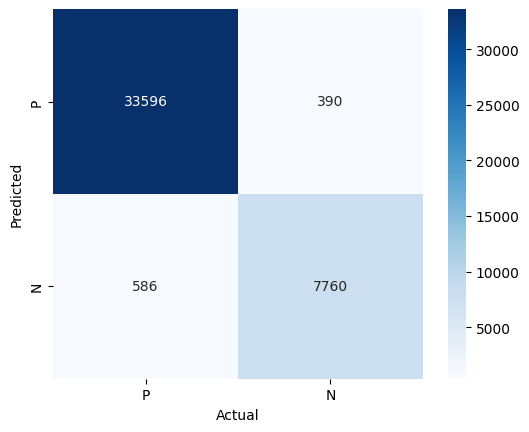

In [ ]:
confusion_matrix_best_params = metrics.confusion_matrix(y_test_pca, y_pred_best_pca_rf)
ax = seaborn.heatmap(confusion_matrix_best_params, xticklabels='PN', yticklabels='PN', annot=True, square=True, cmap='Blues', fmt=".0f")
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

In [ ]:
model_name = 'LGBM PCA 95'
pipe_lgbm_bal_pca = Pipeline([('scaler', StandardScaler()), ('lgbm',LGBMClassifier(random_state = 42))])
pipe_lgbm_bal_pca.fit(X_train_pca, y_train_pca)


# Create RandomizedSearchCV with custom scorer
lgbm_random_search_pca = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_lgbm_bal_pca,
    param_distributions=params_grid_lgbm,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
lgbm_random_search_pca.fit(X_train_pca, y_train_pca)
cv_results = lgbm_random_search_pca.cv_results_
print(cv_results['mean_test_score'])

lgbm_random_search_pca.fit(X_train_pca, y_train_pca)

start_time = time.time()
y_pred_best_pca_lgbm = lgbm_random_search_pca.predict(X_test_pca)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test_pca, y_pred_best_pca_lgbm)*100,
    'Accuracy': accuracy_score(y_test_pca, y_pred_best_pca_lgbm)*100,
    'Precision': precision_score(y_test_pca, y_pred_best_pca_lgbm)*100,
    'F1-score': f1_score(y_test_pca, y_pred_best_pca_lgbm)*100,
})

test_result = pd.concat([test_result,result ])
print(result)
cv_results = lgbm_random_search_pca.cv_results_
print(cv_results['mean_test_score'])

[LightGBM] [Info] Number of positive: 33279, number of negative: 136048
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003768 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4080
[LightGBM] [Info] Number of data points in the train set: 169327, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.196537 -> initscore=-1.408081
[LightGBM] [Info] Start training from score -1.408081
[LightGBM] [Info] Number of positive: 33279, number of negative: 136048
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003917 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 4080
[LightGBM] [Info] Number of data points in the train set: 169327, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.196537 -> initscore=-1.408081
[LightGBM] [Info] Start training from score -1.408081
[0.95419

In [ ]:
### XGBOOST HYPERPARAMETRING
model_name = 'XGBoost PCA 95'

pipe_xgb_bal_pca = Pipeline([('scaler', StandardScaler()), ('xgb',xgb.XGBClassifier(random_state = 42))])
pipe_xgb_bal_pca.fit(X_train_pca, y_train_pca)



xgb_random_search_pca= RandomizedSearchCV(estimator=xgb.XGBClassifier(random_state=42),
                                      param_distributions=params_grid_xgb, n_iter=10,
                                      cv=5, random_state=42,
                                      scoring=scorer,
                                      n_jobs=-1)

xgb_random_search_pca.fit(X_train_pca, y_train_pca)
cv_results = xgb_random_search_pca.cv_results_
print(cv_results['mean_test_score'])

print(xgb_random_search_pca.best_params_)

xgb_random_search_pca.fit(X_train_pca, y_train_pca)

start_time = time.time()
y_pred_best_pca_xgb = xgb_random_search_pca.predict(X_test_pca)
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test_pca, y_pred_best_pca_xgb)*100,
    'Accuracy': accuracy_score(y_test_pca, y_pred_best_pca_xgb)*100,
    'Precision': precision_score(y_test_pca, y_pred_best_pca_xgb)*100,
    'F1-score': f1_score(y_test_pca, y_pred_best_pca_xgb)*100,
})

test_result = pd.concat([test_result,result ])
print(result)


c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning: 
15 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
    ~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\xgboost\core.py", line 726, in inner_f
    return func(**kwargs)
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Py

[0.95371639 0.95604518        nan 0.95495299 0.95428972        nan
 0.94980058        nan 0.95480604 0.95466542]
{'colsample_bytree': np.float64(0.901249477568232), 'learning_rate': np.float64(0.06998494949080172), 'max_depth': 8, 'min_child_weight': 4, 'n_estimators': 422, 'subsample': np.float64(0.841003510568888)}


c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_validation.py:540: FitFailedWarning: 
15 fits failed out of a total of 50.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\sklearn\model_selection\_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
    ~~~~~~~~~~~~~^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\xgboost\core.py", line 726, in inner_f
    return func(**kwargs)
  File "c:\Users\Jaque\AppData\Local\Programs\Python\Py

            Model  Recall  Accuracy  Precision  F1-score
0  XGBoost PCA 95   93.30     97.78      95.36     94.32


In [ ]:
print("\n XGBoost - 16 componentes")
print(classification_report(y_test_pca, y_pred_best_pca_xgb,digits=4))


 XGBoost - 16 componentes
              precision    recall  f1-score   support

         0.0     0.9836    0.9888    0.9862     33986
         1.0     0.9536    0.9330    0.9432      8346

    accuracy                         0.9778     42332
   macro avg     0.9686    0.9609    0.9647     42332
weighted avg     0.9777    0.9778    0.9778     42332



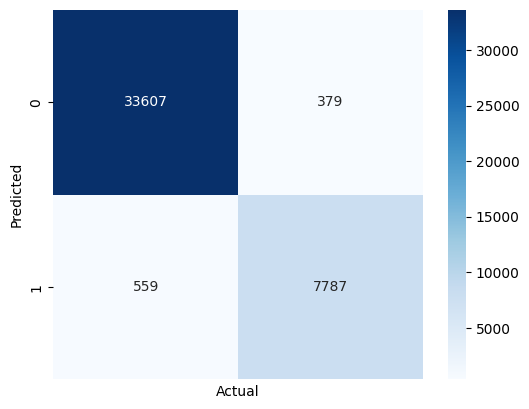

In [ ]:
confusion_matrix_best_params = metrics.confusion_matrix(y_test_pca, y_pred_best_pca_xgb)
ax = sns.heatmap(confusion_matrix_best_params, xticklabels=0, yticklabels=1,
                 annot=True, square=True, cmap='Blues', fmt=".0f")
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

####SHap value analysis

#####Shap Analysis for XGBoost best model

c:\Users\Jaque\AppData\Local\Programs\Python\Python313\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Original Feature Importance (ranked by Mean SHAP Value):
             Feature  Mean_SHAP_Value
0     frequent_terms             4.25
11   lenght_hostname             1.42
17  quantity_numeric             0.86
15         lenght_fd             0.73
3        quantity(.)             0.51
19    contains_https             0.50
18  quantity_letters             0.48
16        lenght_tld             0.42
10        url_lenght             0.19
4       quantity(ww)             0.13

--- Evaluating with SHAP Threshold: 0.1 ---
Number of features selected: 11
Metrics: F1=0.9461, ROC AUC=0.9928, Precision=0.9599, Recall=0.9326, Accuracy=0.9791

--- Evaluating with SHAP Threshold: 0.05 ---
Number of features selected: 14
Metrics: F1=0.9481, ROC AUC=0.9930, Precision=0.9612, Recall=0.9353, Accuracy=0.9798

--- Evaluating with SHAP Threshold: 0.01 ---
Number of features selected: 14
Metrics: F1=0.9481, ROC AUC=0.9930, Precision=0.9612, Recall=0.9353, Accuracy=0.9798

--- Evaluating with SHAP Threshold: 

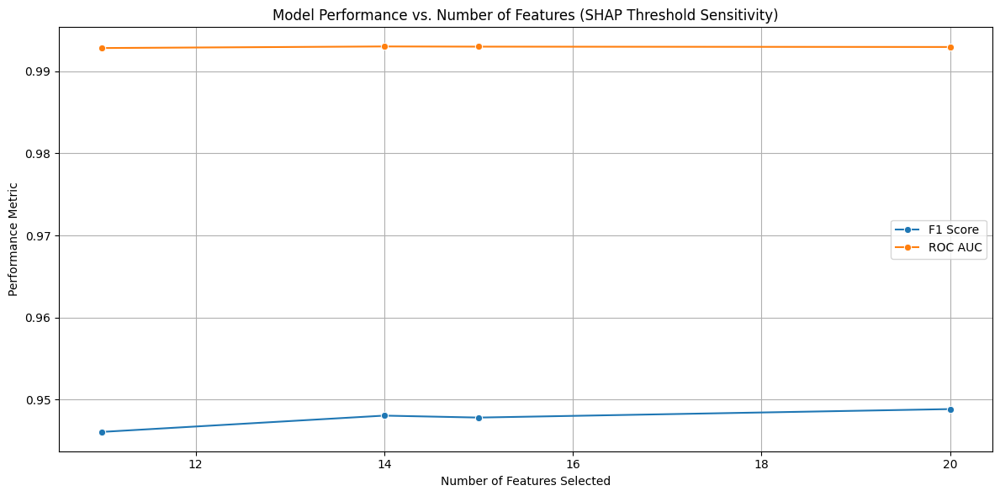

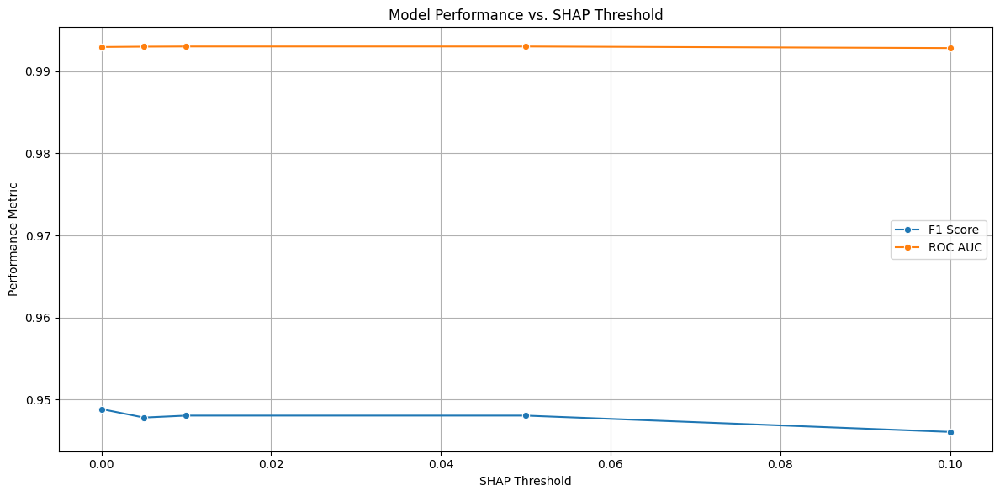

In [ ]:
import shap


# Use the best estimator from the random search
best_xgb_model =xgb_random_search.best_estimator_

# Explain the model's predictions using SHAP
explainer = shap.TreeExplainer(best_xgb_model.named_steps['xgb'])
shap_values = explainer.shap_values(X_resampled)

# For binary classification, shap_values often returns a list [shap_for_class_0, shap_for_class_1]
# We typically use the SHAP values for the positive class (class 1) for feature importance.
if isinstance(shap_values, list) and len(shap_values) == 2:
    shap_values_to_use = shap_values[1] # For the positive class (class 1)
else:
    shap_values_to_use = shap_values # For regression or if it's already a single array

# Calculate mean absolute SHAP values for each feature
feature_importance = np.mean(np.abs(shap_values_to_use), axis=0)

# Create a DataFrame for better visualization
feature_importance_df = pd.DataFrame({
    'Feature': X_train.columns,
    'Mean_SHAP_Value': feature_importance
})

# Sort the DataFrame by descending order of importance
feature_importance_df = feature_importance_df.sort_values(by='Mean_SHAP_Value', ascending=False)

print("Original Feature Importance (ranked by Mean SHAP Value):")
print(feature_importance_df.head(10)) # Show top 10 for brevity

# --- 3. Define the thresholds for sensitivity analysis ---
# You can customize these thresholds
thresholds = [ 0.005, 0.01, 0.05, 0.1] # Added more thresholds for a richer analysis
# Also add a "no selection" case (threshold 0 or None)
thresholds.append(0.0) # Represents using all features

results = []
best_f1_score = -1
best_threshold = None
best_num_features = 0
best_model = None # To store the best performing model

# --- 4. Iterate through thresholds and evaluate new models ---
for threshold in sorted(thresholds, reverse=True): # Start with higher thresholds (fewer features) or sort as desired
    print(f"\n--- Evaluating with SHAP Threshold: {threshold} ---")

    if threshold == 0.0:
        selected_feature_names = X_train.columns.tolist() # Use all features
        print("Using all features (Threshold 0.0)")
    else:
        # Select features based on the current threshold
        selected_features_df = feature_importance_df[feature_importance_df['Mean_SHAP_Value'] >= threshold]
        selected_feature_names = selected_features_df['Feature'].tolist()

    if not selected_feature_names:
        print(f"No features selected for threshold {threshold}. Skipping model training.")
        results.append({
            'Threshold': threshold,
            'Num_Features': 0,
            'F1_Score': np.nan,
            'ROC_AUC': np.nan,
            'Precision': np.nan,
            'Recall': np.nan,
            'Accuracy': np.nan,
            'Selected_Features': []
        })
        continue

    print(f"Number of features selected: {len(selected_feature_names)}")
    # print(f"Selected features: {selected_feature_names}") # Uncomment if you want to see all names

    # Prepare data with only selected features
    X_train_selected = X_train[selected_feature_names]
    X_test_selected = X_test[selected_feature_names]

    # Retrain a new LGBM model within a pipeline (if using StandardScaler)
    # Using a pipeline is crucial if you have preprocessing steps

    best_xgb_model.fit(X_train_selected, y_train)

    # Evaluate the performance of the new model
    y_pred = best_xgb_model.predict(X_test_selected)
    y_pred_proba = best_xgb_model.predict_proba(X_test_selected)[:, 1] # Probability of the positive class

    f1 = f1_score(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    precision = precision_score(y_test, y_pred)
    recall = recall_score(y_test, y_pred)
    accuracy = accuracy_score(y_test, y_pred)

    print(f"Metrics: F1={f1:.4f}, ROC AUC={roc_auc:.4f}, Precision={precision:.4f}, Recall={recall:.4f}, Accuracy={accuracy:.4f}")

    results.append({
        'Threshold': threshold,
        'Num_Features': len(selected_feature_names),
        'F1_Score': f1,
        'ROC_AUC': roc_auc,
        'Precision': precision,
        'Recall': recall,
        'Accuracy': accuracy,
        'Selected_Features': selected_feature_names # Store the list of selected features
    })

    # Track the best result based on F1-Score (you can change this metric)
    if recall > best_f1_score:
        best_f1_score = f1
        best_threshold = threshold
        best_num_features = len(selected_feature_names)
        best_model = best_xgb_model # Store the actual fitted pipeline
        best_selected_features = selected_feature_names

# --- 5. Summarize and Identify the Best Result ---
results_df = pd.DataFrame(results).sort_values(by='F1_Score', ascending=False) # Sort to easily see the best
print("\n--- Sensitivity Analysis Results (Sorted by F1-Score) ---")
print(results_df.round(4)) # Round for cleaner display

print(f"\n--- Best Training Result (based on F1-Score on test set) ---")
print(f"Best Threshold: {best_threshold}")
print(f"Number of Features: {best_num_features}")
print(f"Best F1 Score: {best_f1_score:.4f}")
print(f"Selected Features for Best Result: {best_selected_features}")

# The 'best_model' variable now holds the fitted pipeline that yielded the best F1-score
print("\nThe best performing pipeline is stored in 'best_model' variable.")
# You can now use best_model to make predictions on new data:
# new_unseen_data = X_new[best_selected_features] # Ensure new data has same columns
# final_predictions = best_model.predict(new_unseen_data)


# --- 6. Visualize Results ---
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 6))
sns.lineplot(data=results_df, x='Num_Features', y='F1_Score', marker='o', label='F1 Score')
sns.lineplot(data=results_df, x='Num_Features', y='ROC_AUC', marker='o', label='ROC AUC')
plt.title('Model Performance vs. Number of Features (SHAP Threshold Sensitivity)')
plt.xlabel('Number of Features Selected')
plt.ylabel('Performance Metric')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(12, 6))
sns.lineplot(data=results_df, x='Threshold', y='F1_Score', marker='o', label='F1 Score')
sns.lineplot(data=results_df, x='Threshold', y='ROC_AUC', marker='o', label='ROC AUC')
plt.title('Model Performance vs. SHAP Threshold')
plt.xlabel('SHAP Threshold')
plt.ylabel('Performance Metric')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
results_df

,Threshold,Num_Features,F1_Score,ROC_AUC,Precision,Recall,Accuracy,Selected_Features
4,0.00,20,0.95,0.99,0.96,0.94,0.98,"[frequent_terms, contains_sTLD, abnormal_url, ..."
2,0.01,14,0.95,0.99,0.96,0.94,0.98,"[frequent_terms, lenght_hostname, quantity_num..."
1,0.05,14,0.95,0.99,0.96,0.94,0.98,"[frequent_terms, lenght_hostname, quantity_num..."
3,0.01,15,0.95,0.99,0.96,0.94,0.98,"[frequent_terms, lenght_hostname, quantity_num..."
0,0.10,11,0.95,0.99,0.96,0.93,0.98,"[frequent_terms, lenght_hostname, quantity_num..."


In [ ]:
results_df = results_df[results_df['Threshold'] != 0.0]

max_recall = results_df['Recall'].max()

# Step 2: Filter rows that match the maximum recall
filtered = results_df[results_df['Recall'] == max_recall]

# (Optional) Step 2.5: If you also want the max accuracy among those
# max_accuracy = filtered['Accuracy'].max()
# filtered = filtered[filtered['Accuracy'] == max_accuracy]

# Step 3: Among those, pick the row with the maximum threshold
best_row = filtered.loc[filtered['Threshold'].idxmax()]

print(best_row.Selected_Features)
selected_features_shap = best_row.Selected_Features

['frequent_terms', 'lenght_hostname', 'quantity_numeric', 'lenght_fd', 'quantity(.)', 'contains_https', 'quantity_letters', 'lenght_tld', 'url_lenght', 'quantity(ww)', 'quantity(-)', 'quantity_directories', 'quantity(=)', 'quantity(?)']


In [ ]:
selected_features_shap = best_row.Selected_Features

#####Shap Analysis for Random Forest best model


In [ ]:
model_name = 'XGBoost SHAP'
pipe_xgb_bal = Pipeline([('scaler', StandardScaler()), ('xgb',xgb.XGBClassifier(random_state = 42))])
pipe_xgb_bal.fit(X_resampled[selected_features_shap], y_resampled.values.flatten())


xgb_random_search = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_xgb_bal,
    param_distributions=param_grid_xgb,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
xgb_random_search.estimator.fit(X_resampled[selected_features_shap], y_resampled)

xgb_shap = xgb_random_search.estimator['xgb']
xgb_shap.fit(X_resampled[best_selected_features], y_resampled)
recall = cross_val_score(xgb_shap, X_resampled[best_selected_features], y_resampled, cv=10, scoring='recall', n_jobs=-1)
accuracy = cross_val_score(xgb_shap, X_resampled[best_selected_features], y_resampled, cv=10, scoring='accuracy',n_jobs=-1)
nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})
y_xgb_random_search = xgb_shap.predict(X_test[best_selected_features])

result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_xgb_random_search)*100,
    'Accuracy': accuracy_score(y_test, y_xgb_random_search)*100,
    'Precision': precision_score(y_test, y_xgb_random_search)*100,
    'F1-score': f1_score(y_test, y_xgb_random_search)*100,
})

test_result = pd.concat([test_result,result ])
print(result)
nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})

          Model  Recall  Accuracy  Precision  F1-score
0  XGBoost SHAP   95.80     97.26      90.77     93.21


          Model  Recall  Accuracy  Precision  F1-score
0  XGBoost SHAP   95.77     97.28      90.88     93.26


In [ ]:
### RANDOMFOREST HYPERPARAMETRING
model_name = 'RandomForest SHAP'

pipe_rf_bal = Pipeline([('scaler', StandardScaler()), ('rfc',RandomForestClassifier(random_state = 42))])
pipe_rf_bal.fit(X_resampled[selected_features_shap], y_resampled)
scoring = ['accuracy', 'precision']
params_grid_rfc ={
    'rfc__n_estimators': [50,100, 150, 200],
    'rfc__criterion': ['gini', 'entropy'],
    'rfc__max_depth': [None, 5, 10, 20],
    'rfc__min_samples_split': [2, 5, 10],
    'rfc__min_samples_leaf': [1, 2, 4],
    'rfc__max_features': [None,'sqrt', 'log2']
}


# Create RandomizedSearchCV with custom scorer
rf_random_search = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_rf_bal,
    param_distributions=params_grid_rfc,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
rf_random_search.fit(X_resampled[selected_features_shap], y_resampled)
cv_results = rf_random_search.cv_results_
print(cv_results['mean_test_score'])

#Test RandomForest Best Model
model_name = 'Random Forest SHAP'
start_time = time.time()
y_pred_rf_bal_shap = rf_random_search.predict(X_test[selected_features_shap])
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_rf_bal_shap)*100,
    'Accuracy': accuracy_score(y_test, y_pred_rf_bal_shap)*100,
    'Precision': precision_score(y_test, y_pred_rf_bal_shap)*100,
    'F1-score': f1_score(y_test, y_pred_rf_bal_shap)*100,
})


test_result = pd.concat([test_result,result ])
print(result)
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[0.92987237 0.95370871 0.92987237 0.95331832 0.96146396 0.95347598
 0.93036787 0.95339339 0.9611036  0.93039039]
                Model  Recall  Accuracy  Precision  F1-score
0  Random Forest SHAP   95.72     97.18      90.50     93.04


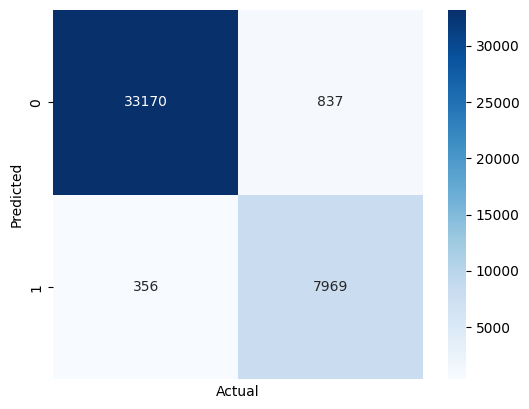

In [ ]:
confusion_matrix_best_params = metrics.confusion_matrix(y_test, y_pred_rf_bal_shap)
ax = sns.heatmap(confusion_matrix_best_params, xticklabels=0, yticklabels=1,
                 annot=True, square=True, cmap='Blues', fmt=".0f")
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

In [ ]:
#Test RandomForest Best Model
model_name = 'LightGBM SHAP'


pipe_lgm_bal = Pipeline([('scaler', StandardScaler()), ('lgbm',LGBMClassifier(random_state = 42))])
pipe_lgm_bal.fit(X_resampled[selected_features_shap], y_resampled)
scoring = ['accuracy', 'precision']

# Create RandomizedSearchCV with custom scorer
lgbm_random_search = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_lgm_bal,
    param_distributions=params_grid_lgbm,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
lgbm_random_search.fit(X_resampled[selected_features_shap], y_resampled)


start_time = time.time()
y_pred_lgbm_bal_shap = lgbm_random_search.predict(X_test[selected_features_shap])
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_lgbm_bal_shap)*100,
    'Accuracy': accuracy_score(y_test, y_pred_lgbm_bal_shap)*100,
    'Precision': precision_score(y_test, y_pred_lgbm_bal_shap)*100,
    'F1-score': f1_score(y_test, y_pred_lgbm_bal_shap)*100,
})

cv_results = lgbm_random_search.cv_results_
print(cv_results)
test_result = pd.concat([test_result,result ])
print(result)
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[LightGBM] [Info] Number of positive: 33300, number of negative: 33300
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 906
[LightGBM] [Info] Number of data points in the train set: 66600, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Number of positive: 33300, number of negative: 33300
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002483 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 906
[LightGBM] [Info] Number of data points in the train set: 66600, number of used features: 14
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000

In [ ]:
test_result

,Model,Recall,Accuracy,Precision,F1-score
0,Random Forest Best Model,95.71,97.16,90.40,92.98
0,XGBoost Best Model,95.82,97.31,91.00,93.35
0,LBGM Best Model,96.02,97.28,90.69,93.28
0,Random Forest FS(median),91.95,95.41,85.72,88.73
0,LightGBM FS(median),93.91,95.20,83.67,88.49
0,XGBoost FS(median),93.09,96.01,87.42,90.17
0,Random Forest PCA 95,92.98,97.69,95.21,94.08
0,LGBM PCA 95,93.43,97.74,95.04,94.23
0,XGBoost PCA 95,93.30,97.78,95.36,94.32
0,XGBoost SHAP,95.80,97.26,90.77,93.21


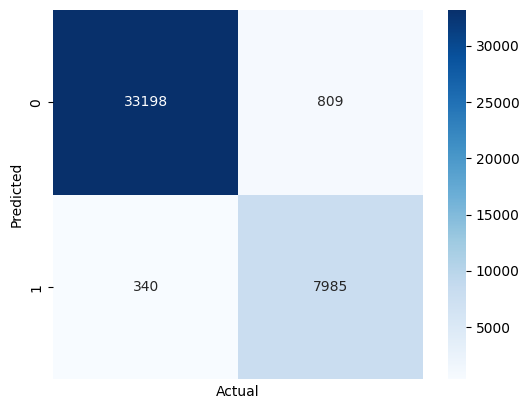

In [ ]:
confusion_matrix_best_params = metrics.confusion_matrix(y_test, y_pred_lgbm_bal_shap)
ax = sns.heatmap(confusion_matrix_best_params, xticklabels=0, yticklabels=1,
                 annot=True, square=True, cmap='Blues', fmt=".0f")
ax.set_xlabel('Actual')
ax.set_ylabel('Predicted')
plt.show()

In [ ]:
mean_accuracy_by_model.sort_values()

model
Logistic Regression Balanced   92.31
Logistic Regression            94.99
Gradient Boosting balanced     95.17
Random Forest Balanced         96.47
LGBM balanced                  96.47
Gradient Boosting              96.48
XGBoost balanced               96.58
LightGBM                       97.67
Random Forest                  97.75
XGBoost                        97.79
Name: accuracy, dtype: object

In [ ]:
mean_recall_by_model.sort_values()

model
Logistic Regression            80.32
Gradient Boosting              87.17
Logistic Regression Balanced   91.26
Random Forest                  93.36
LightGBM                       93.41
XGBoost                        93.56
Gradient Boosting balanced     93.74
Random Forest Balanced         95.77
LGBM balanced                  95.83
XGBoost balanced               95.92
Name: recall, dtype: object

In [ ]:
df_time_to_predict.drop_duplicates().sort_values(by=["model","time"])

,model,time
4,Gradient Boosting,41.84
9,Gradient Boosting balanced,40.91
8,LGBM balanced,17.11
3,LightGBM,18.14
0,Logistic Regression,6.04
5,Logistic Regression Balanced,9.23
1,Random Forest,442.67
6,Random Forest Balanced,390.52
2,XGBoost,12.55
7,XGBoost balanced,11.17


In [ ]:
test_result

,Model,Recall,Accuracy,Precision,F1-score
0,Random Forest Best Model,95.71,97.16,90.40,92.98
0,XGBoost Best Model,95.82,97.31,91.00,93.35
0,LBGM Best Model,96.02,97.28,90.69,93.28
0,Random Forest FS(median),91.95,95.41,85.72,88.73
0,LightGBM FS(median),93.91,95.20,83.67,88.49
0,XGBoost FS(median),93.09,96.01,87.42,90.17
0,Random Forest PCA 95,92.98,97.69,95.21,94.08
0,LGBM PCA 95,93.43,97.74,95.04,94.23
0,XGBoost PCA 95,93.30,97.78,95.36,94.32
0,XGBoost SHAP,95.80,97.26,90.77,93.21


In [ ]:
from sklearn.feature_selection import chi2
# Calculate Chi-Square statistics
chi2_scores, p_values = chi2(X_resampled, y_resampled)

# Create a DataFrame for results
results_df = pd.DataFrame({'Feature': X_resampled.columns,
                          'Chi2_Score': chi2_scores,
                          'p_value': p_values})

# Sort by p-value
results_df = results_df.sort_values(by='p_value')

# Select features with p-value < 0.05
selected_features_chi_square = results_df[results_df['p_value'] < 0.05]['Feature'].tolist()


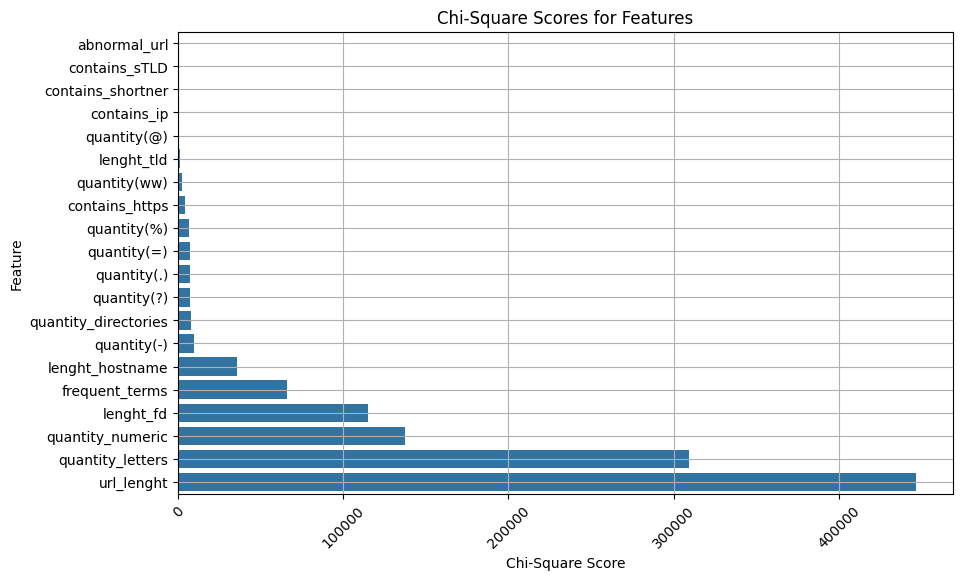

In [ ]:
# Create a bar plot
plt.figure(figsize=(10, 6))
results_df = results_df.sort_values(by='Chi2_Score')
sns.barplot(x='Chi2_Score', y='Feature', data=results_df, orient='h')

# Customize the plot
plt.xlabel('Chi-Square Score')
plt.ylabel('Feature')
plt.title('Chi-Square Scores for Features')
plt.grid(True)

# Rotate x-axis labels for better readability
plt.xticks(rotation=45)

# Show the plot
plt.show()

In [ ]:
model_name = 'LightGBM Chi2'


pipe_lgm_bal_chi = Pipeline([('scaler', StandardScaler()), ('lgbm',LGBMClassifier(random_state = 42))])
pipe_lgm_bal_chi.fit(X_resampled[selected_features_chi_square], y_resampled)
scoring = ['accuracy', 'precision']

# Create RandomizedSearchCV with custom scorer
lgbm_random_search_chi = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_lgm_bal_chi,
    param_distributions=params_grid_lgbm,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
lgbm_random_search_chi.fit(X_resampled[selected_features_chi_square], y_resampled)


start_time = time.time()
y_pred_lgbm_bal_chi = lgbm_random_search_chi.predict(X_test[selected_features_chi_square])
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_lgbm_bal_chi)*100,
    'Accuracy': accuracy_score(y_test, y_pred_lgbm_bal_chi)*100,
    'Precision': precision_score(y_test, y_pred_lgbm_bal_chi)*100,
    'F1-score': f1_score(y_test, y_pred_lgbm_bal_chi)*100,
})

cv_results = lgbm_random_search_chi.cv_results_
print(cv_results)
test_result = pd.concat([test_result,result ])
print(result)
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[LightGBM] [Info] Number of positive: 33300, number of negative: 33300
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001655 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 954
[LightGBM] [Info] Number of data points in the train set: 66600, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Number of positive: 33300, number of negative: 33300
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002576 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 954
[LightGBM] [Info] Number of data points in the train set: 66600, number of used features: 18
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000

In [ ]:
### RANDOMFOREST HYPERPARAMETRING
model_name = 'RandomForest Chi2'

pipe_rf_bal_chi = Pipeline([('scaler', StandardScaler()), ('rfc',RandomForestClassifier(random_state = 42))])
pipe_rf_bal_chi.fit(X_resampled[selected_features_chi_square], y_resampled)

# Create RandomizedSearchCV with custom scorer
rf_random_search_chi = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_rf_bal_chi,
    param_distributions=params_grid_rfc,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
rf_random_search_chi.fit(X_resampled[selected_features_chi_square], y_resampled)
cv_results = rf_random_search.cv_results_
print(cv_results['mean_test_score'])

#Test RandomForest Best Model
model_name = 'Random Forest SHAP'
start_time = time.time()
y_pred_rf_bal_chi = rf_random_search_chi.predict(X_test[selected_features_chi_square])
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_pred_rf_bal_chi)*100,
    'Accuracy': accuracy_score(y_test, y_pred_rf_bal_chi)*100,
    'Precision': precision_score(y_test, y_pred_rf_bal_chi)*100,
    'F1-score': f1_score(y_test, y_pred_rf_bal_chi)*100,
})


test_result = pd.concat([test_result,result ])
print(result)
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})

[0.92545045 0.95414414 0.92678679 0.9537012  0.96146396 0.95307808
 0.92753003 0.95368619 0.96053303 0.9276952 ]
                Model  Recall  Accuracy  Precision  F1-score
0  Random Forest SHAP   95.72     97.16      90.38     92.98


In [ ]:
model_name = 'XGBoost CHI2'
pipe_xgb_bal_chi = Pipeline([('scaler', StandardScaler()), ('xgb',xgb.XGBClassifier(random_state = 42))])
pipe_xgb_bal_chi.fit(X_resampled[selected_features_shap], y_resampled.values.flatten())


xgb_random_search = RandomizedSearchCV(
    n_jobs=-1,
    scoring=scorer,  # Use the custom scorer
    estimator=pipe_xgb_bal_chi,
    param_distributions=params_grid_xgb,
    n_iter=10,
    cv=10,
    random_state=42,
    refit=True  # Refit the estimator with the best parameters based on the custom scorer
)
xgb_random_search.estimator.fit(X_resampled[selected_features_chi_square], y_resampled)

xgb_shap = xgb_random_search.estimator['xgb']
xgb_shap.fit(X_resampled[selected_features_chi_square], y_resampled)
recall = cross_val_score(xgb_shap, X_resampled[selected_features_chi_square], y_resampled, cv=10, scoring='recall', n_jobs=-1)
accuracy = cross_val_score(xgb_shap, X_resampled[selected_features_chi_square], y_resampled, cv=10, scoring='accuracy',n_jobs=-1)
nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})

start_time = time.time()
y_xgb_random_search_chi = xgb_shap.predict(X_test[selected_features_chi_square])
end_time = time.time()
elapsed_time_ms = (end_time - start_time) * 1000
time_to_predict.append({'model': model_name, 'time': elapsed_time_ms})


result= pd.DataFrame({
    'Model': [model_name],
    'Recall': recall_score(y_test, y_xgb_random_search_chi)*100,
    'Accuracy': accuracy_score(y_test, y_xgb_random_search_chi)*100,
    'Precision': precision_score(y_test, y_xgb_random_search_chi)*100,
    'F1-score': f1_score(y_test, y_xgb_random_search_chi)*100,
})

test_result = pd.concat([test_result,result ])
print(result)
nfold_results.append({'model': model_name, 'recall': recall, 'accuracy': accuracy})

          Model  Recall  Accuracy  Precision  F1-score
0  XGBoost CHI2   95.99     97.19      90.33     93.08


In [ ]:
"""RESULTADOS"""
df_nfold_results = pd.DataFrame(nfold_results)
cv_scores = pd.concat([cv_scores,df_nfold_results.explode(['recall', 'accuracy'])])
df_temp =pd.DataFrame(time_to_predict)
df_time_to_predict = pd.concat([df_time_to_predict,df_temp])
cv_scores.to_csv(path_source_code+"cv_scores_total.csv")
test_result.to_csv(path_source_code+"test_result_total.csv")
df_time_to_predict.to_csv(path_source_code+"time_to_predict_total.csv")

In [ ]:
mean_accuracy_by_model = cv_scores.groupby('model')['accuracy'].mean()*100
mean_recall_by_model = cv_scores.groupby('model')['recall'].mean()*100

In [ ]:
mean_recall_by_model.sort_values()

model
Logistic Regression            80.32
LightGBM FS(median)            85.72
Gradient Boosting              87.17
Logistic Regression Balanced   91.26
Random Forest                  93.36
LightGBM                       93.41
XGBoost                        93.56
XGBoost FS(median)             93.63
Gradient Boosting balanced     93.74
Random Forest Balanced         95.77
Random Forest FS(median)       95.79
LGBM balanced                  95.83
XGBoost balanced               95.92
XGBoost SHAP                   95.92
XGBoost CHI2                   95.94
Name: recall, dtype: object

In [ ]:
mean_accuracy_by_model.sort_values()

model
LightGBM FS(median)            89.61
Logistic Regression Balanced   92.31
Logistic Regression            94.99
XGBoost FS(median)             95.11
Gradient Boosting balanced     95.17
Random Forest FS(median)       96.44
Random Forest Balanced         96.47
LGBM balanced                  96.47
Gradient Boosting              96.48
XGBoost SHAP                   96.56
XGBoost balanced               96.58
XGBoost CHI2                   96.61
LightGBM                       97.67
Random Forest                  97.75
XGBoost                        97.79
Name: accuracy, dtype: object

In [ ]:
df_time_to_predict.sort_values(by="time")

,model,time
0,Logistic Regression,7.29
0,Logistic Regression,7.29
0,Logistic Regression,7.29
0,Logistic Regression,7.29
5,Logistic Regression Balanced,7.40
5,Logistic Regression Balanced,7.40
5,Logistic Regression Balanced,7.40
17,XGBoost FS(median),18.45
17,XGBoost FS(median),18.45
2,XGBoost,20.92
